### Udacity Data Science Nanodegree
### Project 1: Writing a Data Scientist Blog Post
---

# Part II - London Airbnb Data - EDA
## by Juanita Smith

- [Introduction](#intro)
- [Data gathering](#getdata)
- [Feature Engineering](#featureeng)
- [Univariate Exploratoin](#univariate)
- [Bivariate Exploratoin](#bivariate)
- [Multivariate Exploration](#multivariate)
- [Clustering](#clustering)
- [Preprocessing](#preprocessing)
- [Modelling Step 1 - Setting a baseline with Ridge and small alpha](#baseline)
- [Modelling Step 2 - Model improvement with RidgeCV](#model_improve)
- [Conclusions](#conclusions)
- [References](#references)
- [Submission](#submission)

<a id='intro'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Introduction</span>

### Context:
Since 2008, guests and hosts have used Airbnb to travel in a more unique, personalized way. As part of the Airbnb Inside initiative, this dataset describes the listing activity of homestays in London, United Kingdom.


### Dictionary:

In Part I, Airbnb London listing data was cleaned, and only a subset of the available features was selected to support analysis of below questions.

**Recap of the origin of data:**

Airbnb activity is included for **London** and is a snapshot of booking availability on 8 June 2023

Data was downloaded from Airbnb [here](http://insideairbnb.com/get-the-data/). Scroll down to London section. 

To support this analysis, only listings and calendar data was needed.

Metadata are available [here](https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit#gid=1322284596)

## Are you like me going the Taylor Swift concert in London next June and looking for the best place to stay ?

This project will focus on answering questions below, whilst this notebook focus on **question 4 in blue**

1) Are some hosts running a business, and if so, what is the impact on price ?
> - Can we identify businesses by the duration of rentals ? Are businesses focusing on short or long term term rentals? What impact have rental duration have on price ?
> - Are some hosts running a business with multiple listings ? If so, how does this affect the price ?


2) Host Analysis: How does **host excellence** influence price ?
> - Super hosts seems to describe their properties better, how does this effect price and availability ?


3) What effect does **star ratings** have on property price ?
> - Would a 5-star vs 3-star listing in the same location cost more ?


<span style="color:blue; font-size:20px; line-height:20px; font-family: Calibri;">4) Predict average daily listing price</span>

> - Knowing the impact of host excellence and star ratings above, could we make an accurate average daily price prediction ?

- Assumption: Normality of the predictors or the label
- Assumption 1: Linear Relationship between the Target and the Feature
- Assumption 2: Normality of the Error Terms, meaning residuals should be normally distributed with mean as centre

In [1]:
import os
os.environ["OMP_NUM_THREADS"] = '1'

In [2]:
# import all packages
import numpy as np
import numpy.random as random

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import glob
import missingno as msno
from datetime import datetime

# clear the garbage to free memory as we are working with huge datasets
import gc 
from sklearn.experimental import enable_iterative_imputer
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV, Ridge, Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, PredictionErrorDisplay, median_absolute_error, silhouette_score, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler, StandardScaler, FunctionTransformer, OneHotEncoder

from sklearn.compose import TransformedTargetRegressor

import scipy as sp
from patsy import dmatrices

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import VarianceThreshold  
from sklearn.compose import TransformedTargetRegressor, make_column_selector, ColumnTransformer

import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.model_selection import RepeatedKFold, cross_validate, RepeatedStratifiedKFold
from sklearn.pipeline import make_pipeline, Pipeline

from statsmodels.stats.diagnostic import normal_ad

from sklearn.mixture import GaussianMixture

from sklearn.cluster import KMeans
from sklearn.feature_selection import mutual_info_regression

from pickle import dump

# import warnings
# warnings.filterwarnings("ignore")

# Import custom modules
from project1_blog.src.utils import reduce_mem_usage, create_folder, entity_recognision, fit_imputer
import project1_blog.src.visuals as vs

# set plots to be embedded inline
%matplotlib inline

# suppress matplotlib user warnings
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")
warnings.filterwarnings("ignore", category=UserWarning, module="sklearn")

# # use high resolution if this project is run on an apple device
%config InlineBackend.figure_format='retina'

# Make your Jupyter Notebook wider
from IPython.display import display, HTML
display(HTML('<style>.container { width:80% !important; }</style>'))

# environment settings
# display all columns and rows during visual inspection
pd.options.display.max_columns = 999
pd.options.display.max_rows = 999

# stop scientific notation on graphs
# pd.options.display.float_format = '{:.0f}'.format

import geopandas as gpd
from shapely.geometry import Point
from pyproj import CRS
import contextily as ctx
import numba

gpd.options.display_precision = 15

In [3]:
# set default plot formatting and colors
BASE_COLOR, BASE_HIGHLIGHT_INTENSE, BASE_HIGHLIGHT, BASE_COMPLIMENTARY, BASE_GREY, BASE_COLOR_SUB1, BASE_COLOR_SUB2, SYMBOLS = vs.set_plot_defaults()

In [4]:
# default file paths
# FILE_NAME_RAW = '../data/clean/listing_clean.pkl'
# FILE_NAME_CLEAN = '../data/clean/listing_clean.pkl'
FILE_NAME_ENHANCED = '../data/clean/listing_enhanced.pkl'

In [5]:
random_state = 88

In [110]:
def func(x):
    return np.log10(x)

def inverse_func(x):
    return sp.special.exp10(x)

def goodness_of_fit(y, y_hat, show=False):
    """ 
    Calculates and returns the performance score between true and predicted values based on the metric chosen. 
    """

    #Calculate the performance scores
    r2 = r2_score(y, y_hat)
    mse = mean_squared_error(y, y_hat) 
    mae = mean_absolute_error(y, y_hat) 
    maeEd = median_absolute_error(y, y_hat) 

    if show:
        print("R-squared: {:.2f}".format(r2))
        print("Mean Squared Error (MSE): {:.2f}".format(mse))
        print("Median Absolute Error: {:.2f}".format(maeEd))    
        print("Mean Absolute Error: {:.2f}".format(mae))  
        

    return {
        "R-squared": f"{r2_score(y, y_hat):.3f}",
        "Median Absolute Error": f"{median_absolute_error(y, y_hat):.3f}",
        "Mean Absolute Error": f"{mean_absolute_error(y, y_hat):.3f}",
        "Mean Squared Error": f"{mean_squared_error(y, y_hat):.3f}",
    }  

def get_mi_score(X, y):
    mi = mutual_info_regression(X, y, random_state=10)
    mi = pd.Series(mi, index=X.columns).sort_values(ascending=False)
    return mi

In [7]:
def calculate_residuals(model, X, y):
    """
    Creates predictions on the features with the model and calculates residuals
    """
    predictions = model.predict(X)
    df_results = pd.DataFrame({'Actual': y, 'Predicted': predictions})
#     df_results = df_results.reset_index()
    df_results['Residuals'] = abs(df_results['Actual']) - abs(df_results['Predicted'])
    
    return df_results

In [317]:
def plot_model_performance_scatter(
    y, y_pred1, y_pred2, title1, title2, suptitle, kind='actual_vs_predicted', lower_lim=-200, upper_lim=1500, interval=100, figsize=(12,6)):
    """ 
    Compare the performance of 2 models plotting its predictions vs actual values
    """

    bins = np.arange(lower_lim, upper_lim+interval, interval)
    fig, (ax0, ax1) = plt.subplots(1, 2, sharey=True, figsize=figsize)

    plt.subplot(1,2,1)

    PredictionErrorDisplay.from_predictions(
        y,
        y_pred1,
        kind=kind,
        ax=ax0,
        scatter_kwargs={"alpha": 0.3, 'marker':'o', 'color':BASE_HIGHLIGHT_INTENSE, 's':50, 'edgecolor':'black', 'linewidths':0.3}
    )
    
    if kind == 'actual_vs_predicted':
        ax0.set_xticks(bins, bins, rotation=90)
        ax0.set_yticks(bins, bins)
        ax0.set_xlim(lower_lim,upper_lim)
        ax0.set_ylim(lower_lim,upper_lim)
    else:
        ax0.set_xticks(bins, bins, rotation=90)        
        ax0.set_xlim(lower_lim,upper_lim)        

    plt.subplot(1,2,2)
    PredictionErrorDisplay.from_predictions(
        y,
        y_pred2,
        kind=kind,
        ax=ax1,
        scatter_kwargs={"alpha": 0.3, 'marker':'o', 'color':BASE_HIGHLIGHT_INTENSE, 's':50, 'edgecolor':'black', 'linewidths':0.3},
    )
    
    if kind == 'actual_vs_predicted':
        ax1.set_xticks(bins, bins, rotation=90)
        ax1.set_yticks(bins, bins)
        ax1.set_xlim(lower_lim,upper_lim)
        ax1.set_ylim(lower_lim,upper_lim) 
        loc = 'upper left'  
    else:
        ax1.set_xticks(bins, bins, rotation=90)        
        ax1.set_xlim(lower_lim,upper_lim)
        loc = 'upper right'
        
    ax1.yaxis.set_tick_params(labelleft=True)

    # Add the score in the legend of each axis
    for ax, y_pred in zip([ax0, ax1], [y_pred1, y_pred2]):
        for name, score in goodness_of_fit(y_train, y_pred).items():
            ax.plot([], [], " ", label=f"{name}={score}")
        ax.legend(loc=loc)

    ax0.set_title(title1)
    ax1.set_title(title2)
    fig.suptitle(suptitle)
    plt.show()

In [205]:
def plot_model_performance_hist(y, y_pred1, y_pred2, title1=None, title2=None, suptitle=None, figsize=(14,10)):
    """ Compare performance of 2 models by plotting actual vs predicted target with seaborn histogram """

    # Actual vs predicted price comparision
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=figsize, sharex=True, sharey=True)

    # create bins with £25 intervals
    xbins = np.arange(0, 1225, 25)

    ax1 = sns.histplot(y, bins=xbins, stat='percent', kde=False, color=BASE_COLOR, label='actual', ax=ax1)
    sns.histplot(y_pred1, bins=xbins, stat='percent', kde=False, color=BASE_COMPLIMENTARY, alpha=0.5, label='predicted', ax=ax1)
    ax1.set_title(title1)
    
    ax2 = sns.histplot(y, bins=xbins, stat='percent', kde=False, color=BASE_COLOR, label='actual')
    sns.histplot(y_pred2, bins=xbins, stat='percent', kde=False, color=BASE_COMPLIMENTARY, alpha=0.5, label='predicted', ax=ax2)   
    ax2.set_title(title2)

    plt.xticks(xbins, xbins, rotation=90)
    plt.xlim(0,1200)
    plt.suptitle(suptitle)

    plt.show()

In [10]:
def normal_errors_assumption(model, features, label, ax, p_value_thresh=0.05, title=None):
    """
    Normality: Assumes that the error terms are normally distributed. 
    This means, the error term should have a mean of zero
    If they are not, nonlinear transformations of variables may solve this.
               
    This assumption being violated primarily causes issues with the confidence intervals
    
    p-value from the test - below 0.05 generally means non-normal
    """
    
    # Calculating residuals for the Anderson-Darling test
    df_results = calculate_residuals(model, features, label)

    # Performing the test on the residuals
    p_value = normal_ad(df_results['Residuals'])[1]
    
    # Reporting the normality of the residuals
    if p_value < p_value_thresh:
        text = 'Residuals are not normally distributed'
    else:
        text = 'Residuals are normally distributed'
    
    # Plotting the residuals distribution
    plt.title(title)
    
    ax = sns.histplot(df_results['Residuals'], bins=100, stat='density', kde=True, color=BASE_COLOR)
    ax = sns.kdeplot(df_results['Residuals'], color=BASE_HIGHLIGHT_INTENSE, ax=ax, linewidth=2)
              
    ax.plot([], [], " ", label=f"pvalue={p_value}: {text}")
    ax.legend(loc="upper left")

In [11]:
def distribution_of_errors(model1, model2, X, y, title1=None, title2=None, suptitle=None, alpha=None, figsize=(14,6), kind='kde'):
    """ compare normal distribution of errors for 2 models"""
    
    fig = plt.figure(figsize=figsize)
    
    if kind == 'kde':

        ax = plt.subplot(1,2,1)
        normal_errors_assumption(model=model1, features=X, label=y, ax=ax, title=title1) 

        ax2 = plt.subplot(1,2,2, sharey=ax)
        normal_errors_assumption(model=model2, features=X, label=y, ax=ax2, title=title2) 
        
    elif kind == 'hist':

        ax1 = plt.subplot(1,2,1)
        x = calculate_residuals(model1, X_train, y_train).values.flatten()
        plt.hist(x, bins=100, color=BASE_HIGHLIGHT_INTENSE)
        plt.xlim(-1000, 1000)
        ax1.set_title(title1)
        
        ax1.set_ylabel('Frequency')
        ax1.set_xlabel('Residuals')       

        ax2 = plt.subplot(1,2,2, sharex=ax1, sharey=ax1)
        x = calculate_residuals(model2, X_train, y_train).values.flatten()
        sns.histplot(x, bins=100, color=BASE_HIGHLIGHT_INTENSE)
        ax2.set_title(title2)

        ax2.set_ylabel('Frequency')
        ax2.set_xlabel('Residuals')
        
    plt.suptitle(suptitle, y=1.05)        
    plt.tight_layout()        

In [284]:
def homoscedasticity_assumption(model, X, y, ax):
    """
    Assumption 5: Homoscedasticity of Error Terms: 
    
    Assumes that the errors/residuals have a constant variance, with a mean of 0
    """
       
    # Calculating residuals for the plot
    df_results = calculate_residuals(model, X, y)
    df_results.reset_index(inplace=True)

    sns.scatterplot(x=df_results.index, y=df_results.Residuals, color=BASE_COLOR, marker='o', edgecolor='black', linewidth=0.1, alpha=0.2)
    plt.plot(np.repeat(0, df_results.index.max()), color=BASE_COMPLIMENTARY, linestyle='--')
    ax.spines['right'].set_visible(False)  # Removing the right spine
    ax.spines['top'].set_visible(False)  # Removing the top spine

In [285]:
def residual_variance(model1, model2, X, y, title1=None, title2=None, suptitle=None, figsize=(14,4)):
    """ Compare Homoscedasticityof 2 models """
    
    plt.figure(figsize=figsize)
    
    ax1 = plt.subplot(1,2,1)
    ax1.set_title(title1)
    ax1.set_xlabel('Index')    
    homoscedasticity_assumption(model1, X, y, ax=ax1) 


    ax2 = plt.subplot(1,2,2)
    ax2.set_title(title2)
    ax2.set_xlabel('Index')    
    homoscedasticity_assumption(model2, X, y, ax=ax2) 

    plt.suptitle(suptitle, y=1.05)
    plt.show()

In [286]:
def coef_weights(model, logscale=True):
    '''
    INPUT:
    coefficients - the coefficients of the linear model 
    X_train - the training data, so the column names can be used
    OUTPUT:
    coefs_df - a dataframe holding the coefficient, estimate, and abs(estimate)
    
    Provides a dataframe that can be used to understand the most influential coefficients
    in a linear model by providing the coefficient estimates along with the name of the 
    variable attached to the coefficient.
    '''
    coefs_df = pd.DataFrame()
    coefs_df['est_int'] = feature_names = model[:-1].get_feature_names_out()
    
    try:
        coefs_df['coefs'] = model[-1].coef_
        intercept = model[-1].intercept_
    except:
        coefs_df['coefs'] = model[-1].regressor_.coef_
        intercept = model[-1].regressor_.intercept_
        
    coefs_df['abs_coefs'] = abs(coefs_df['coefs'])
    coefs_df = coefs_df.sort_values('abs_coefs', ascending=False)
    
    coefs_df = coefs_df.set_index('est_int')  
    
    if logscale:
        intercept = inverse_func(intercept)
    
    return coefs_df, (intercept)

In [281]:
def plot_coef(model1, model2, title1, title2, suptitle, figsize=(12,20)):

    plt.subplot(1,2,1)
    coef_df, intercept = coef_weights(model1)
    coef_df['coefs'].plot.barh(figsize=figsize, color=BASE_COLOR)
    plt.title(title1)
    plt.axvline(x=0, color=".5")
    plt.xlabel("Raw coefficient values")
    plt.ylabel('Independent features')
    plt.subplots_adjust(left=0.3)

    plt.subplot(1,2,2)
    coef_df, intercept = coef_weights(model2)
    coef_df['coefs'].plot.barh(figsize=figsize, color=BASE_COLOR)
    plt.title(title2)
    plt.axvline(x=0, color=".5")
    plt.xlabel("Raw coefficient values")
    plt.ylabel('Independent features')
    plt.subplots_adjust(left=0.3)

    plt.suptitle(suptitle, y=1.01)
    plt.tight_layout()

In [290]:
def coefficient_variability(model, X, y, title, suptitle, splits=5, repeats=20, jobs=4, random_state=0, scoring='neg_mean_squared_error', figsize=(10,12)):

    feature_names = model[:-1].get_feature_names_out()

    cv = RepeatedStratifiedKFold(n_splits=splits, n_repeats=repeats, random_state=random_state)

    cv_model = cross_validate(
        model,
        X,
        y,
        scoring=scoring,
        cv=cv,
        return_estimator=True,
        n_jobs=jobs,
        return_train_score=True,
        verbose=0
    )

    try:
        coefs = pd.DataFrame(
            [est[-1].regressor_.coef_ for est in cv_model["estimator"]], columns=feature_names,
        )
    except:
        coefs = pd.DataFrame(
            [est[-1].coef_ for est in cv_model["estimator"]], columns=feature_names,
        )

    plt.figure(figsize=figsize)
    sns.stripplot(data=coefs, orient="h", palette="dark:k", alpha=0.5)
    sns.boxplot(data=coefs, orient="h", color="cyan", saturation=0.5, whis=10)
    plt.axvline(x=0, color=".5")
    plt.xlabel("Coefficient importance")
    plt.title(title)
    suptitle = suptitle
    plt.suptitle(suptitle, y=1.01, x=0.65)
    plt.subplots_adjust(left=0.3)
    plt.tight_layout()

In [335]:
def compare_qqplot(model1, model2, X, y, title1, title2, suptitle, figsize=(8,4)):
    """ Compare QQ plot for 2 models against normal distribution"""
    
    fig, (ax, ax2) = plt.subplots(1, 2, figsize=figsize, sharey=True, sharex=True)
    
    residuals = calculate_residuals(model1, X, y)
    qq = sm.qqplot(data=residuals['Residuals'], line='q', ax=ax, marker='.', markerfacecolor=BASE_COLOR_SUB1, markeredgecolor=BASE_COLOR)    
    
    
    residuals = calculate_residuals(model2, X, y)
    sm.qqplot(data=residuals['Residuals'], line='q', ax=ax2, marker='.', markerfacecolor=BASE_COLOR_SUB2, markeredgecolor=BASE_COLOR)
    
    ax.set_title(title1)
    ax2.set_title(title2)
    plt.suptitle(suptitle, y=1.05)
    plt.show()

In [18]:
# def qqplot(model, X, y, ax, figsize=(8,4)):
#     """ Normal Q-Q plot """
    
#     data = calculate_residuals(model, X, y).values.flatten()
#     data.sort()

#     norm=np.random.normal(0, 2, len(data))
#     norm.sort()

#     ax.plot(norm, data, "o", color=BASE_COLOR)

#     #generate a trend line as in http://widu.tumblr.com/post/43624347354/matplotlib-trendline
#     z = np.polyfit(norm, data, 1)
#     p = np.poly1d(z)
#     ax.plot(norm, p(norm), "k--", linewidth=2)

<a id='getdata'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Gather Data</span>

In [19]:
# features to be used in modelling
cols = ['host_is_superhost', 'accommodates', 'bedrooms', 'bathrooms',
        'minimum_minimum_nights', 'calculated_host_listings_count', 'host_years_active', 'price_mean',
        'private_bathroom', 'host_same_location', 'is_business', 'availability_90', 'neighbourhood_cleansed', 
        'property_type', 'room_type', 'review_scores_location', 'latitude', 'longitude']

In [20]:
# load the enhanced listing file 
listing = pd.read_pickle(FILE_NAME_ENHANCED)
listing.head(3)

,listing_id,listing_url,name,host_id,host_name,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_has_profile_pic,host_identity_verified,neighbourhood_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,price,minimum_minimum_nights,minimum_maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_has_about,host_has_neighborhood_overview,host_years_active,price_mean,private_bathroom,host_same_location,is_business,minimum_night_ranges
0,157714,https://www.airbnb.com/rooms/157714,Townhouse in Hammersmith · ★4.71 · 1 bedroom ·...,757377,Eilinn,within a few hours,90,68,False,Hammersmith,True,True,Hammersmith and Fulham,51.48974,-0.22208,Private room in townhouse,Private room,3,1.5,1.0,1.0,69,4,21,10,37,67,67,175,10,0,2011-07-13,2023-05-02,4.71,4.66,4.78,4.84,4.83,4.76,4.66,False,1,0,1,0,1.21,True,True,12,70,True,True,False,7
1,13913,https://www.airbnb.com/rooms/13913,Rental unit in Islington · ★4.80 · 1 bedroom ·...,54730,Alina,within an hour,100,78,False,LB of Islington,True,True,Islington,51.56861,-0.11270,Private room in rental unit,Private room,1,1.0,1.0,1.0,79,1,29,23,48,78,353,41,15,0,2010-08-18,2022-12-11,4.80,4.72,4.72,4.74,4.82,4.69,4.69,False,2,1,1,0,0.26,True,True,14,79,False,True,False,7
2,15400,https://www.airbnb.com/rooms/15400,Rental unit in London · ★4.80 · 1 bedroom · 1 ...,60302,Philippa,within a day,100,47,False,Chelsea,True,True,Kensington and Chelsea,51.48780,-0.16813,Entire rental unit,Entire home/apt,2,1.0,1.0,1.0,100,7,30,0,2,2,70,94,5,0,2009-12-21,2023-05-01,4.80,4.85,4.88,4.88,4.83,4.93,4.74,False,1,1,0,0,0.57,True,True,14,107,True,True,False,7


In [21]:
# get neighborhood geoshapes for spatial analysis
crs_4326 = CRS("WGS84")
neighbourhood = gpd.read_file('../data/raw/neighbourhood_geojson/london/neighbourhoods_060623.geojson', crs=crs_4326)
neighbourhood.head()

,neighbourhood,neighbourhood_group,geometry
0,Kingston upon Thames,None,MULTIPOLYGON (((-0.330679000000000 51.32901100...
1,Croydon,None,MULTIPOLYGON (((-0.064021000000000 51.31863800...
2,Bromley,None,MULTIPOLYGON (((0.012131000000000 51.299599000...
3,Hounslow,None,MULTIPOLYGON (((-0.244562000000000 51.48870200...
4,Ealing,None,MULTIPOLYGON (((-0.411833000000000 51.53408400...


<a id='featureeng'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Feature engineering</span>

In [22]:
listing_clean = listing.copy()

In [23]:
# make sure that each record is a unique listing  
listing_clean['listing_id'].duplicated().sum()

0

In [24]:
# for easy trouble shooting, lets make listing_id the index
listing_clean = listing_clean.set_index('listing_id')
listing_clean = listing_clean.loc[:, cols]
listing_clean.head()

,host_is_superhost,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,price_mean,private_bathroom,host_same_location,is_business,availability_90,neighbourhood_cleansed,property_type,room_type,review_scores_location,latitude,longitude
listing_id,,,,,,,,,,,,,,,,,,
157714,False,3,1.0,1.5,4,1,12,70,True,True,False,67,Hammersmith and Fulham,Private room in townhouse,Private room,4.76,51.48974,-0.22208
13913,False,1,1.0,1.0,1,2,14,79,False,True,False,78,Islington,Private room in rental unit,Private room,4.69,51.56861,-0.11270
15400,False,2,1.0,1.0,7,1,14,107,True,True,False,2,Kensington and Chelsea,Entire rental unit,Entire home/apt,4.93,51.48780,-0.16813
306333,False,5,2.0,1.0,2,1,11,198,True,False,False,4,Hackney,Entire rental unit,Entire home/apt,4.89,51.52748,-0.08172
159736,False,2,1.0,1.0,4,4,12,62,False,False,False,2,Lambeth,Private room in rental unit,Private room,4.34,51.46788,-0.09993


In [25]:
# make sure features that will be one hot encoded have no spaces in it's values, as it will become part of heading
categorical_columns = ['neighbourhood_cleansed', 'property_type', 'room_type']
listing_clean[categorical_columns] = listing_clean[categorical_columns].apply(lambda x: x.str.replace(' ', '_').str.lower())
listing_clean[categorical_columns] = listing_clean[categorical_columns].apply(lambda x: x.str.replace('/', '_').str.lower())

neighbourhood['neighbourhood'] = neighbourhood['neighbourhood'].apply(lambda x: x.replace(' ', '_').lower())
neighbourhood['neighbourhood'] = neighbourhood['neighbourhood'].apply(lambda x: x.replace('/', '_').lower())

In [26]:
# check for outliers
listing_clean.describe([0.025, 0.25, 0.5, 0.75, 0.9, 0.99, 0.975, 0.999])

,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,price_mean,availability_90,review_scores_location,latitude,longitude
count,68923.000000,68867.000000,68842.000000,68923.000000,68923.000000,68923.000000,68923.000000,68923.000000,47720.000000,68923.000000,68923.000000
mean,3.168014,1.475975,1.338630,4.350202,19.274059,6.251208,202.492608,33.066770,4.709157,51.509690,-0.129571
std,1.985088,0.962448,0.676587,9.065348,62.684541,3.230126,240.753573,31.683168,0.441736,0.048800,0.101330
min,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,7.000000,0.000000,0.000000,51.295937,-0.497800
2.5%,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,30.000000,0.000000,3.670000,51.398398,-0.344240
25%,2.000000,1.000000,1.000000,1.000000,1.000000,4.000000,70.000000,0.000000,4.620000,51.484790,-0.190558
50%,2.000000,1.000000,1.000000,2.000000,2.000000,7.000000,129.000000,26.000000,4.830000,51.513730,-0.129850
75%,4.000000,2.000000,1.500000,4.000000,7.000000,9.000000,232.000000,61.000000,5.000000,51.538970,-0.069360
90%,6.000000,3.000000,2.000000,7.000000,40.000000,10.000000,409.000000,83.000000,5.000000,51.566208,-0.011270
97.5%,8.000000,4.000000,3.000000,28.000000,224.000000,12.000000,990.000000,90.000000,5.000000,51.603030,0.085716


In [27]:
# further remove accessive prices if it's not a business
rows_to_remove = listing_clean[(listing_clean.is_business == False) & (listing_clean.price_mean > 1500)].index
listing_clean = listing_clean.drop(index=rows_to_remove)

In [28]:
# remove records with listings hosting too many people
listing_clean = listing_clean[listing_clean['accommodates'] <= 10]
listing_clean = listing_clean[listing_clean['bedrooms'] <= 7]
listing_clean = listing_clean[listing_clean['bathrooms'] <= 6]
listing_clean = listing_clean[listing_clean['price_mean'].between(30, 1500)]
listing_clean.describe([0.025, 0.25, 0.5, 0.75, 0.9, 0.99, 0.975, 0.999])

,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,price_mean,availability_90,review_scores_location,latitude,longitude
count,66088.000000,66088.000000,66088.000000,66088.000000,66088.000000,66088.000000,66088.000000,66088.00000,46365.000000,66088.000000,66088.000000
mean,3.147137,1.458934,1.320648,4.324537,16.688173,6.234294,189.730299,33.47408,4.714352,51.509413,-0.130212
std,1.815583,0.880110,0.571034,9.047785,51.944386,3.256438,191.230877,31.53513,0.434129,0.048494,0.100742
min,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,30.000000,0.00000,0.000000,51.295937,-0.497800
2.5%,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,35.000000,0.00000,3.670000,51.398662,-0.343498
25%,2.000000,1.000000,1.000000,1.000000,1.000000,4.000000,74.000000,0.00000,4.630000,51.484770,-0.190716
50%,2.000000,1.000000,1.000000,2.000000,2.000000,7.000000,130.000000,27.00000,4.830000,51.513640,-0.130927
75%,4.000000,2.000000,1.500000,4.000000,7.000000,9.000000,229.000000,61.00000,5.000000,51.538261,-0.070130
90%,6.000000,3.000000,2.000000,7.000000,37.000000,10.000000,393.000000,83.00000,5.000000,51.565070,-0.012460
97.5%,8.000000,4.000000,3.000000,28.000000,177.000000,12.000000,784.000000,90.00000,5.000000,51.602528,0.083868


In [29]:
# correct datatypes
listing['neighbourhood_cleansed'] = listing['neighbourhood_cleansed'].astype('category')
listing_clean['bedrooms'] = listing_clean['bedrooms'].astype(int)

In [30]:
listing_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 66088 entries, 157714 to 908453389034894825
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   host_is_superhost               66088 non-null  bool   
 1   accommodates                    66088 non-null  int64  
 2   bedrooms                        66088 non-null  int64  
 3   bathrooms                       66088 non-null  float64
 4   minimum_minimum_nights          66088 non-null  int64  
 5   calculated_host_listings_count  66088 non-null  int64  
 6   host_years_active               66088 non-null  int64  
 7   price_mean                      66088 non-null  int64  
 8   private_bathroom                66088 non-null  bool   
 9   host_same_location              66088 non-null  bool   
 10  is_business                     66088 non-null  bool   
 11  availability_90                 66088 non-null  int64  
 12  neighbourhood_clean

<a id='univariate'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Univariate Analysis</span>

#### Let's double check target feature distribution. Is it normally distributed?

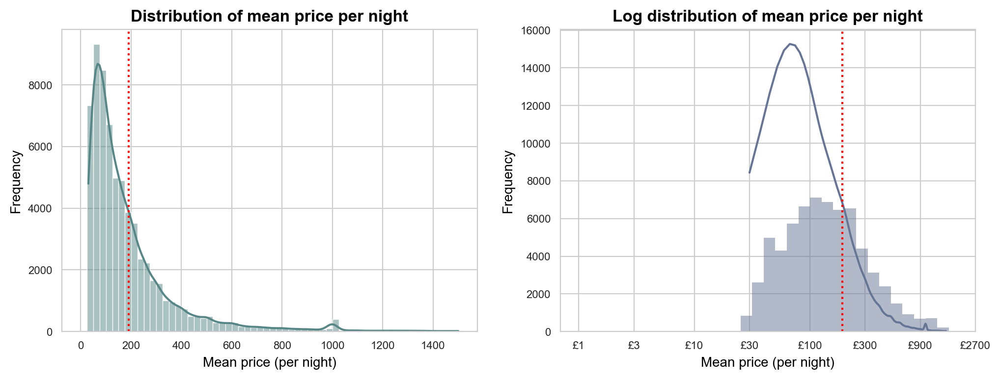

In [31]:
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
xbinsize = 25
xbins = np.arange(0, listing_clean['price_mean'].max()+xbinsize, xbinsize)
sns.histplot(data=listing_clean, x='price_mean', bins=xbins, kde=True, color=BASE_COLOR_SUB1)
plt.axvline(x=listing_clean['price_mean'].mean(), color='r', linestyle=':')
plt.title('Distribution of mean price per night')
plt.xlabel('Mean price (per night)')
plt.ylabel('Frequency')

plt.subplot(1,2,2)
log_binsize = 0.1
xbins = 10 ** np.arange(0, np.log10(listing_clean['price_mean'].max())+log_binsize, log_binsize)
sns.histplot(data=listing_clean, x='price_mean', bins=xbins, color=BASE_COLOR_SUB2, kde=True)
plt.axvline(x=listing_clean['price_mean'].mean(), color='r', linestyle=':')
plt.xscale('log', base=10)
ticks = [1, 3, 10, 30, 100, 300, 900, 2700]
labels = ['£{}'.format(tick) for tick in ticks]
plt.xticks(ticks,labels)

plt.title('Log distribution of mean price per night')
plt.xlabel('Mean price (per night)')
plt.ylabel('Frequency')

plt.show()

>**Observation:**
Mean price is kind of normally distributed on a log scale

#### Let's double check the distribution of independent variables

In [32]:
# we want different approaches for numeric vs categorical features
numerical_features = listing_clean.select_dtypes(include='number').columns.tolist() 
numerical_features.remove('price_mean')
numerical_features.remove('latitude')
numerical_features.remove('longitude')
categorical_features = listing_clean.select_dtypes(exclude='number').columns.tolist() 

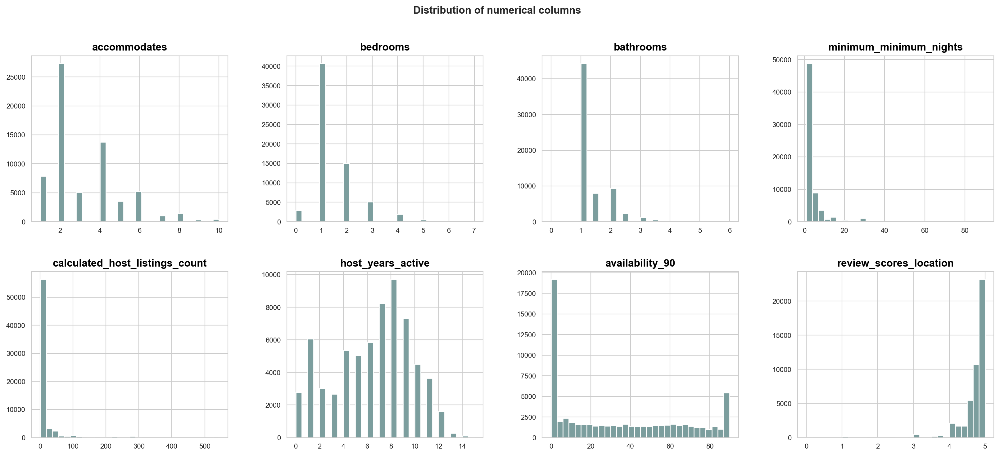

In [33]:
# distribution of numerical columns
pd.plotting.hist_frame(listing_clean, figsize=(20,8), bins=30, layout=(2,4), column=numerical_features, xlabelsize=8, ylabelsize=8, color=BASE_COLOR)
plt.suptitle('Distribution of numerical columns')
plt.show()

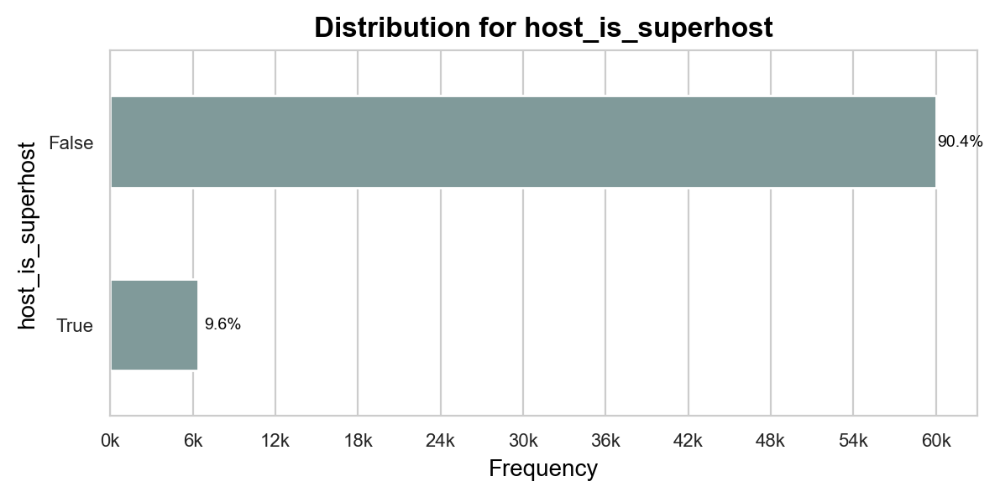

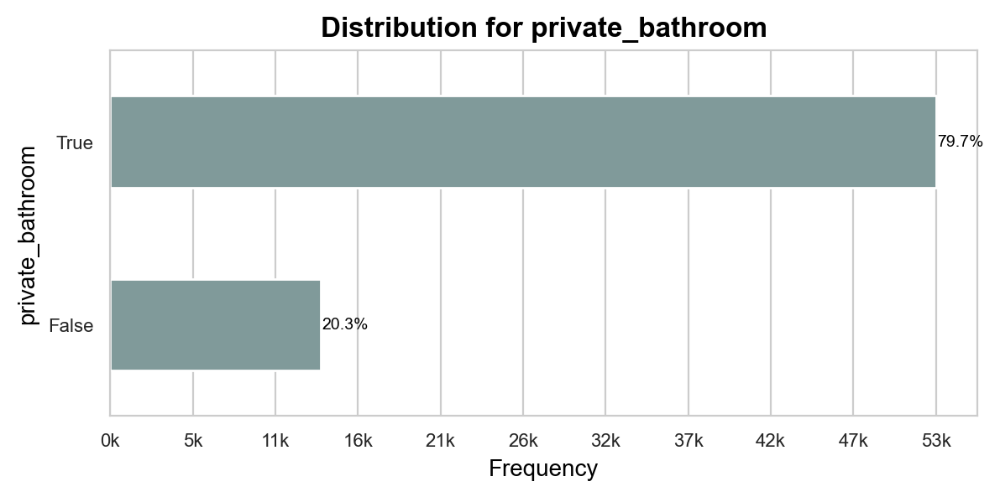

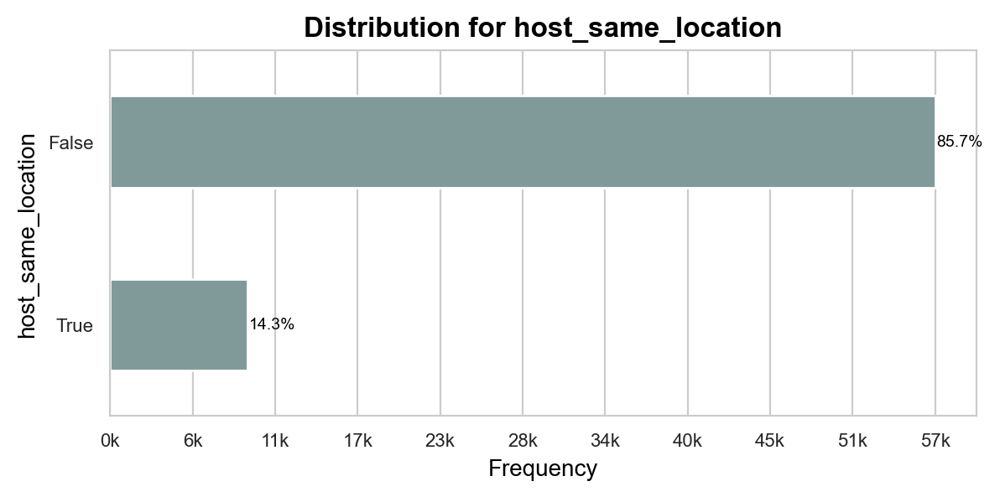

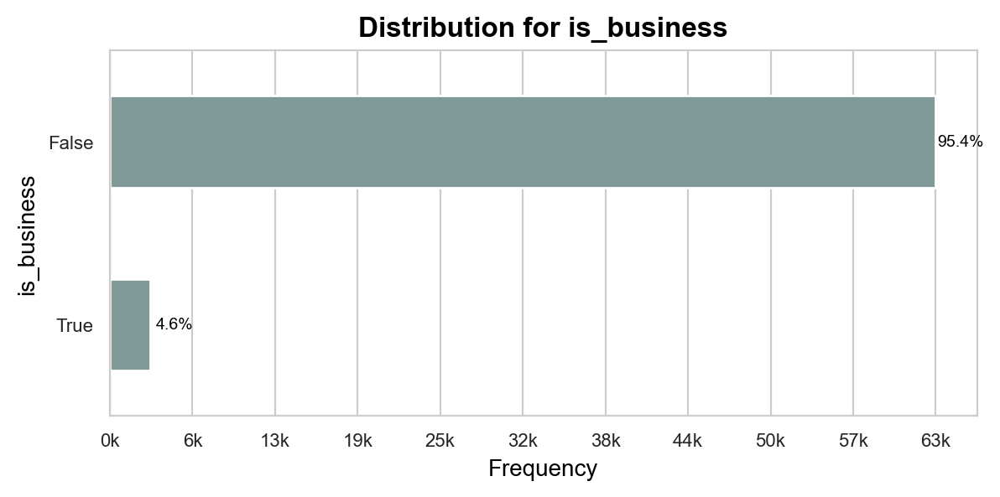

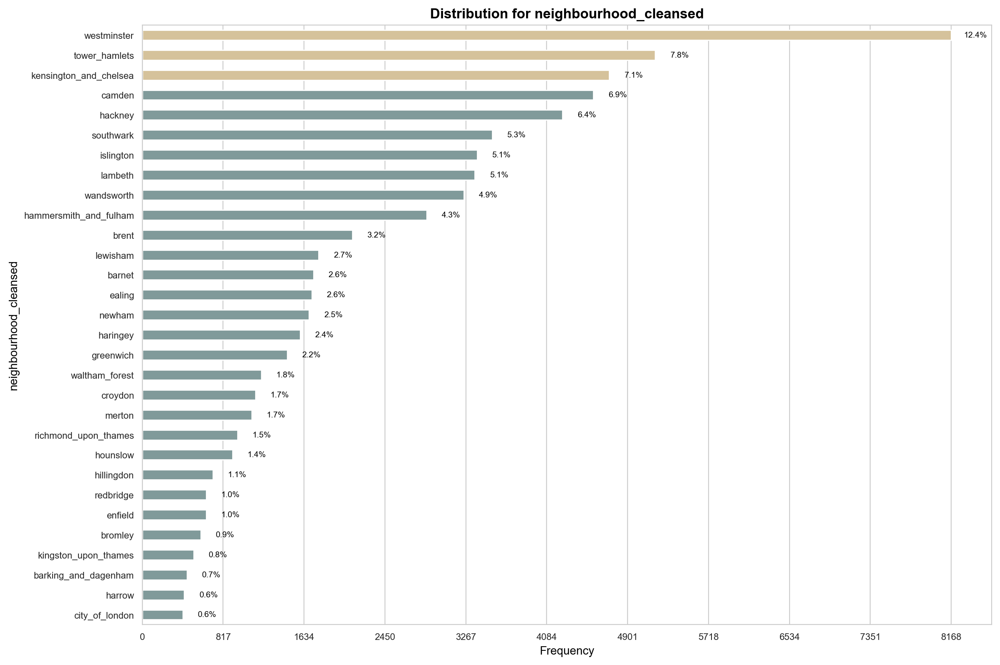

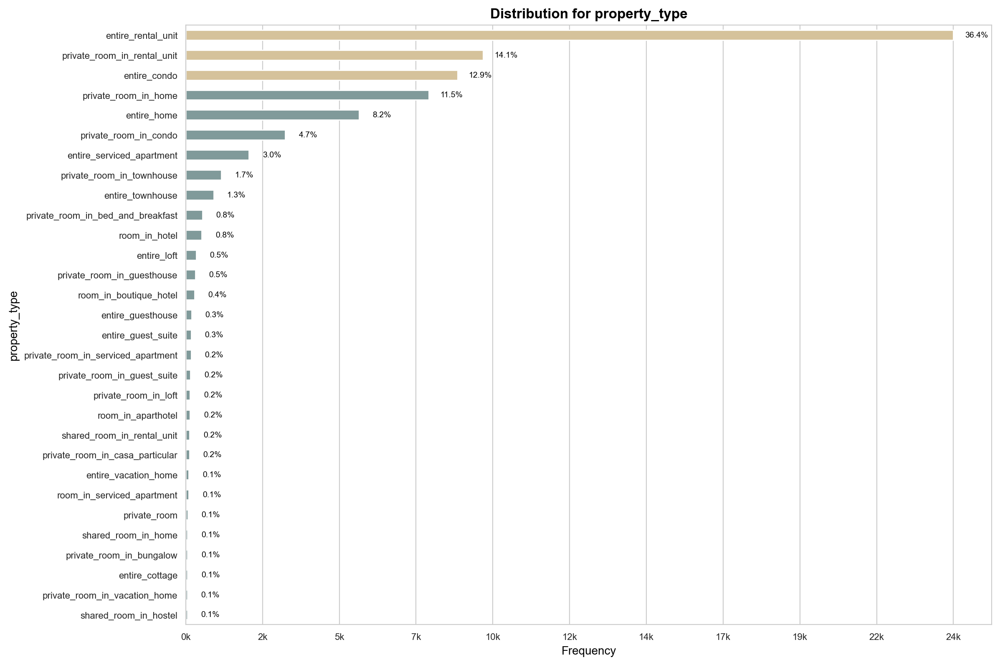

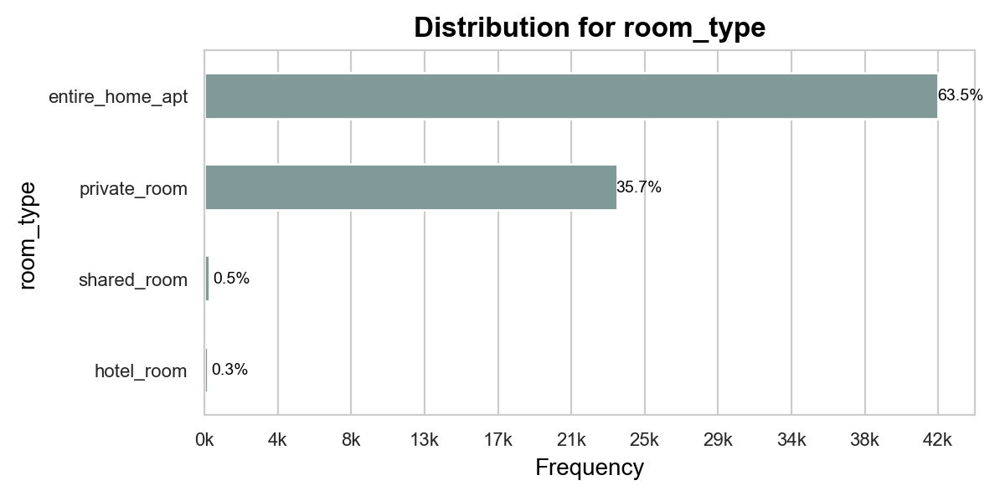

In [34]:
# plot distributions for categorical features
for col in categorical_features:
    vs.hist_by_cat(df=listing_clean, col=col, topn=30)

<a id='bivariate'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Bivariate Analysis</span>

#### Correlation analysis
- Select features correlated with price
- Make sure independent variables does not have too high correlations with each other

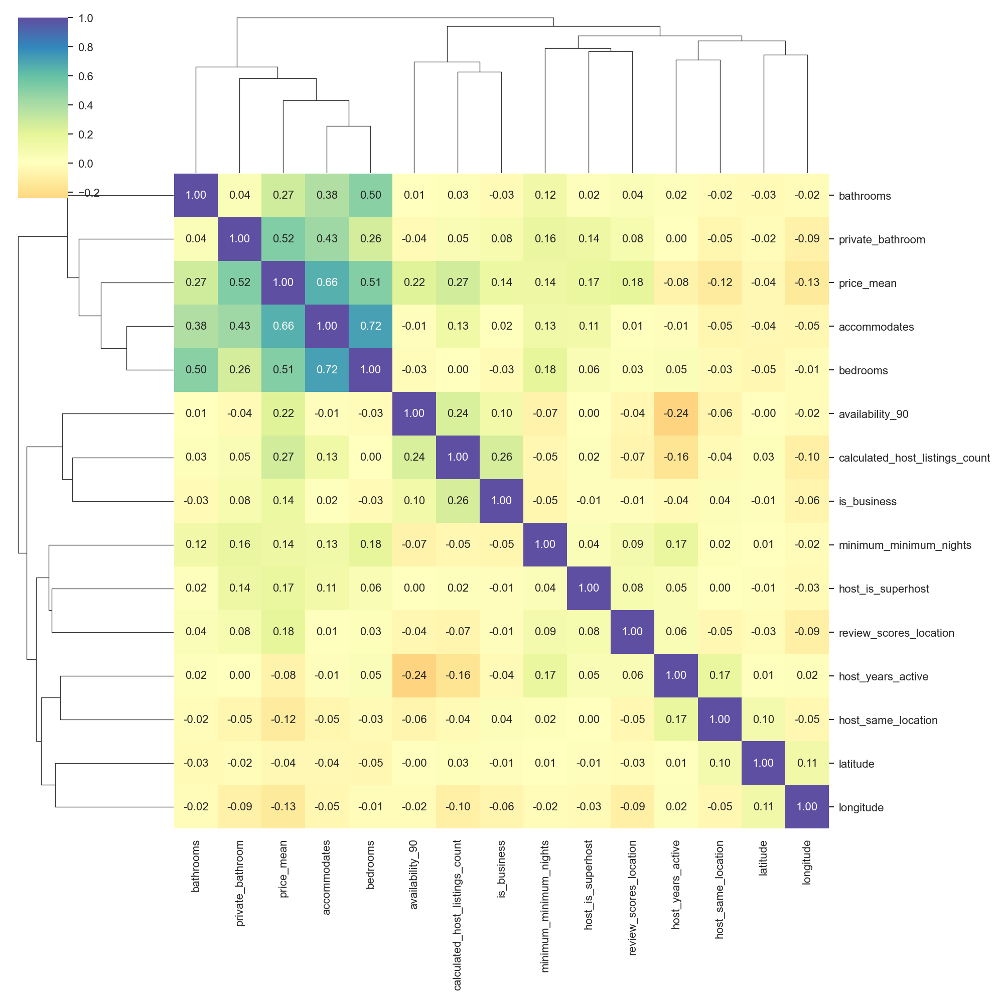

In [35]:
df_corr = listing_clean.corr(method='spearman', numeric_only=True, min_periods=1)
sns.clustermap(df_corr, cmap="Spectral", center=0, annot=True, fmt='.2f', 
               annot_kws={"fontsize":8}, figsize=(10,10))

plt.xticks(fontsize=10)
plt.show()

### Which kind of relationship features have with price ?

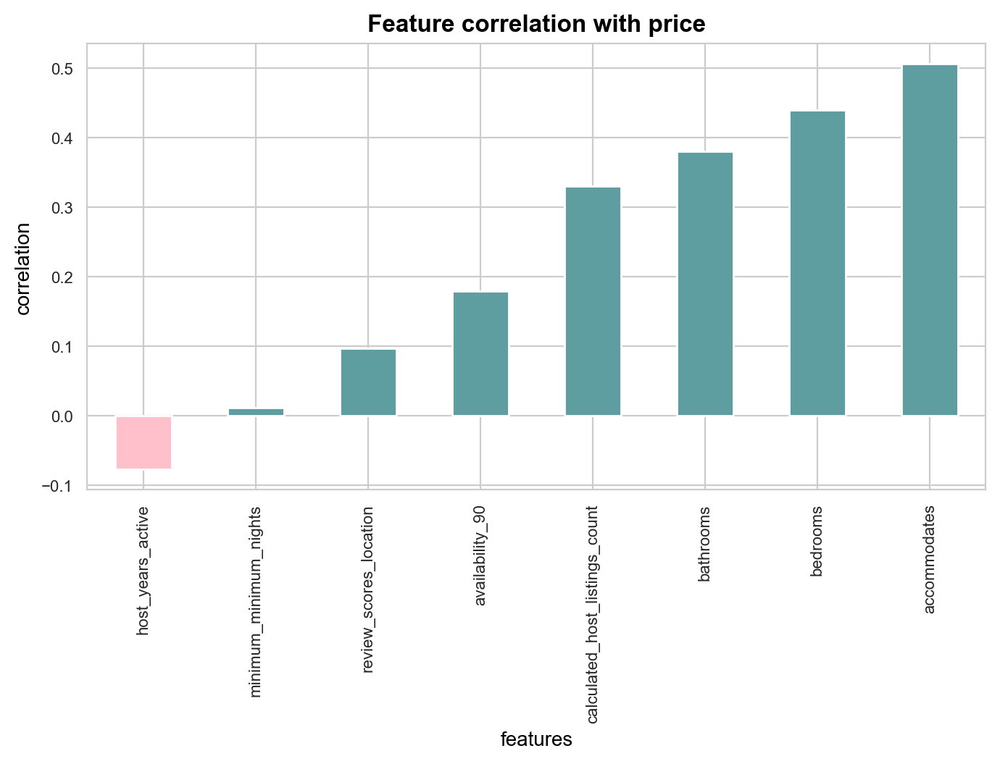

In [36]:
#  Get correlation of features with mean price
corr_matrix = listing_clean[numerical_features].corrwith(listing_clean["price_mean"]).sort_values()

# Plot feature correlations to no_show
palette = sns.color_palette("viridis_r", 15)
pos = 'cadetblue'
neg = 'pink'
corr_matrix.plot(kind='bar', color=np.vectorize({True: pos, False: neg}.get)(corr_matrix > 0))
plt.xticks(rotation='vertical')
plt.ylabel('correlation')
plt.xlabel('features')
plt.title('Feature correlation with price')
plt.show()

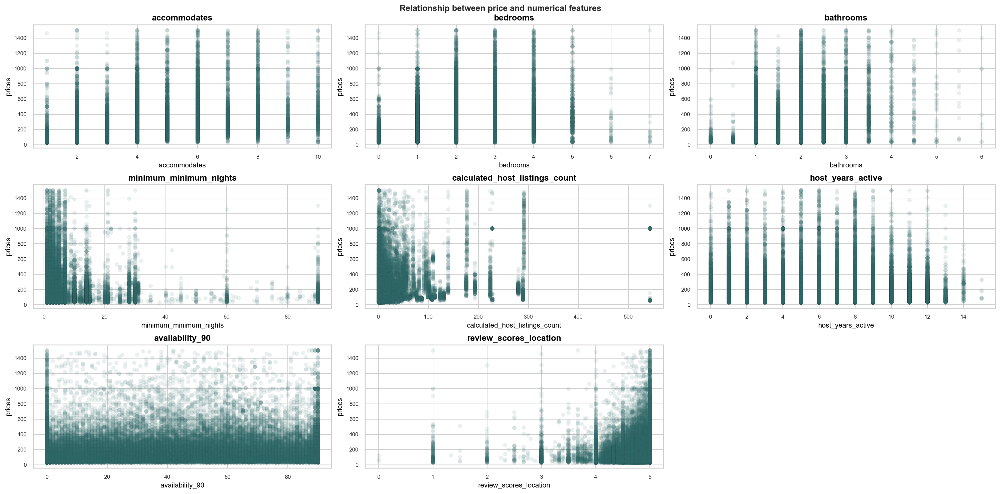

In [49]:
# Display relationship betweeen price and numerical features
plt.figure(figsize=(20, 10))
for i, col in enumerate(numerical_features):
    plt.subplot(3, 3, i+1)
    sns.scatterplot(x=listing_clean[col], y=listing_clean['price_mean'], alpha=0.1, color=BASE_HIGHLIGHT_INTENSE, edgecolor='black', linewidth=0.05)
    plt.title(col)
    plt.xlabel(col)
    plt.ylabel('prices')
plt.suptitle('Relationship between price and numerical features')
plt.tight_layout()

<Figure size 800x400 with 0 Axes>

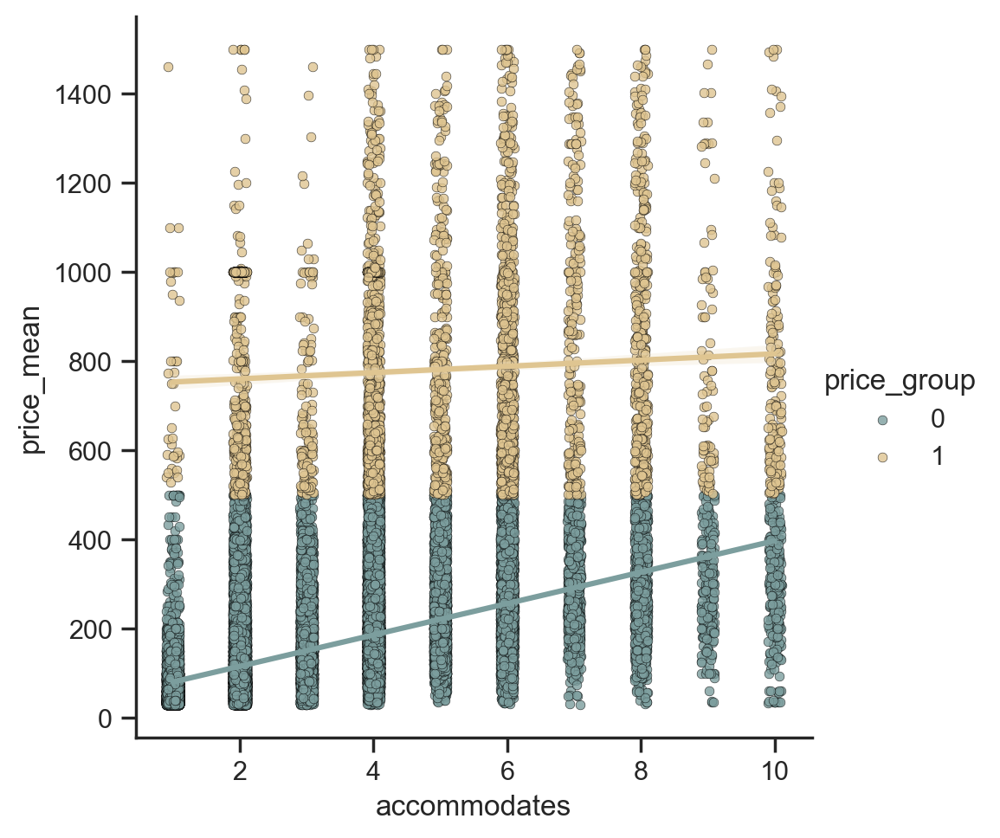

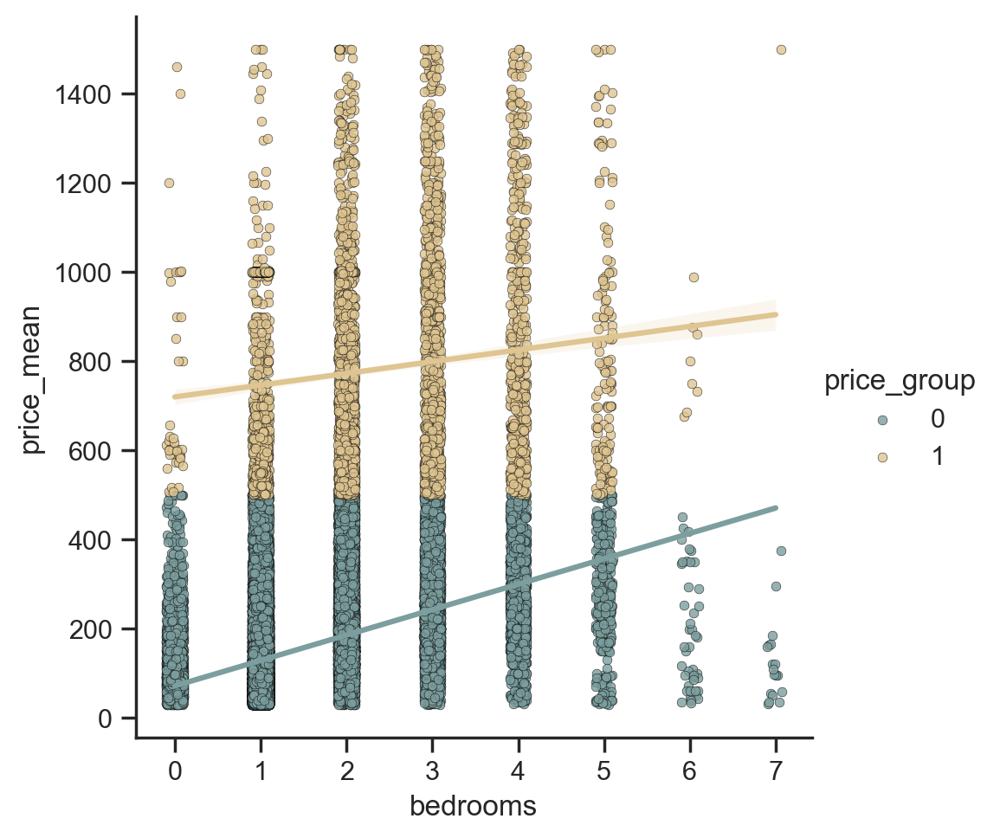

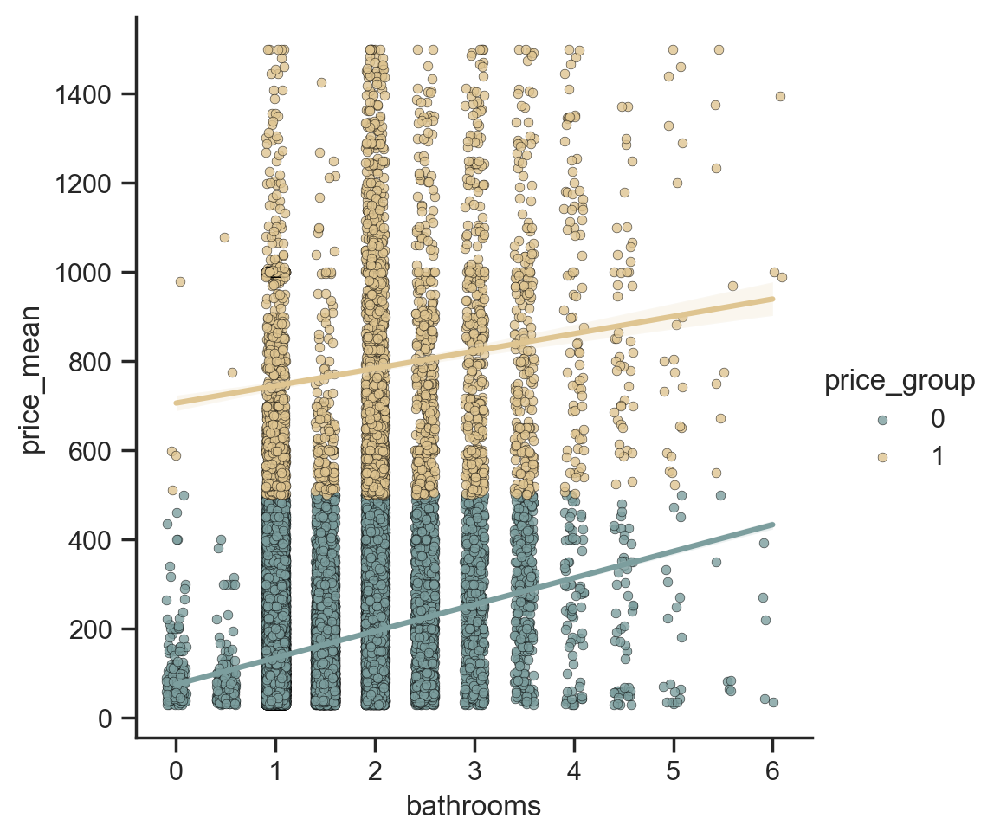

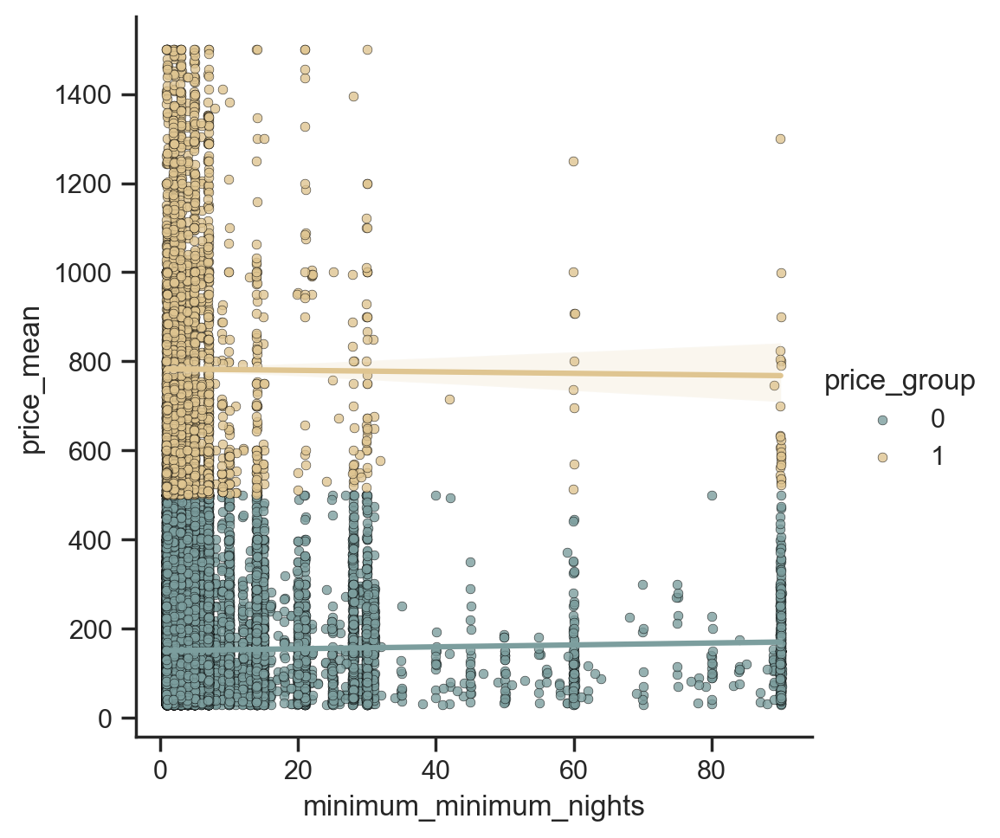

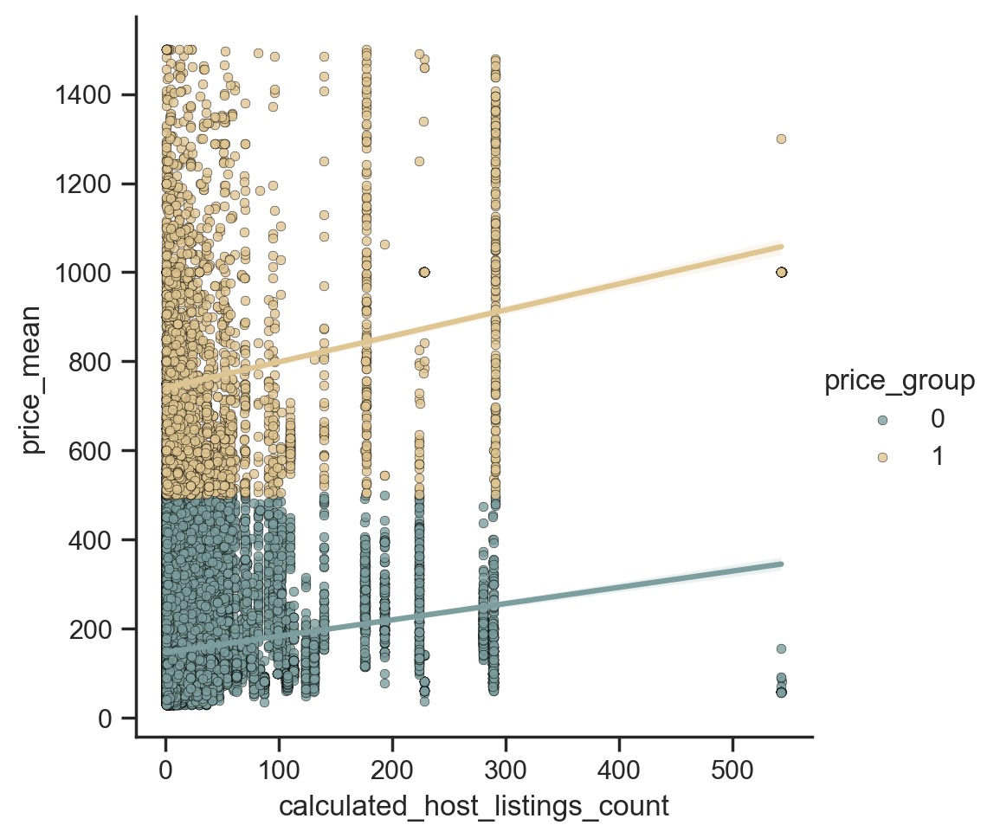

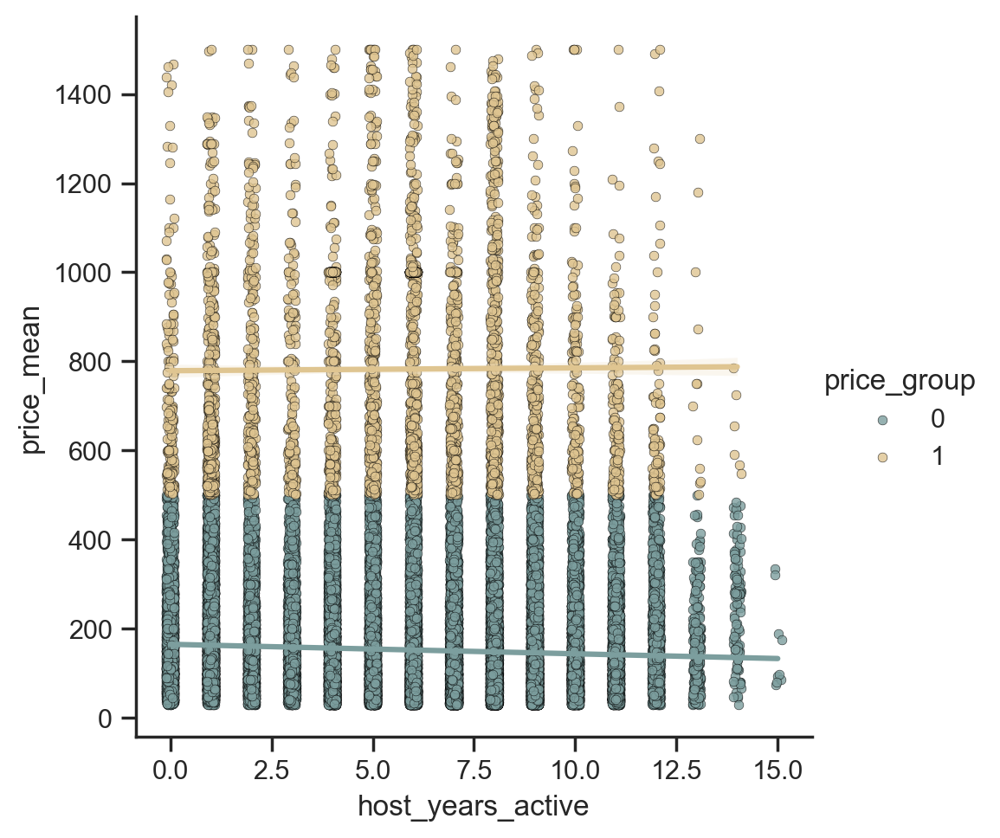

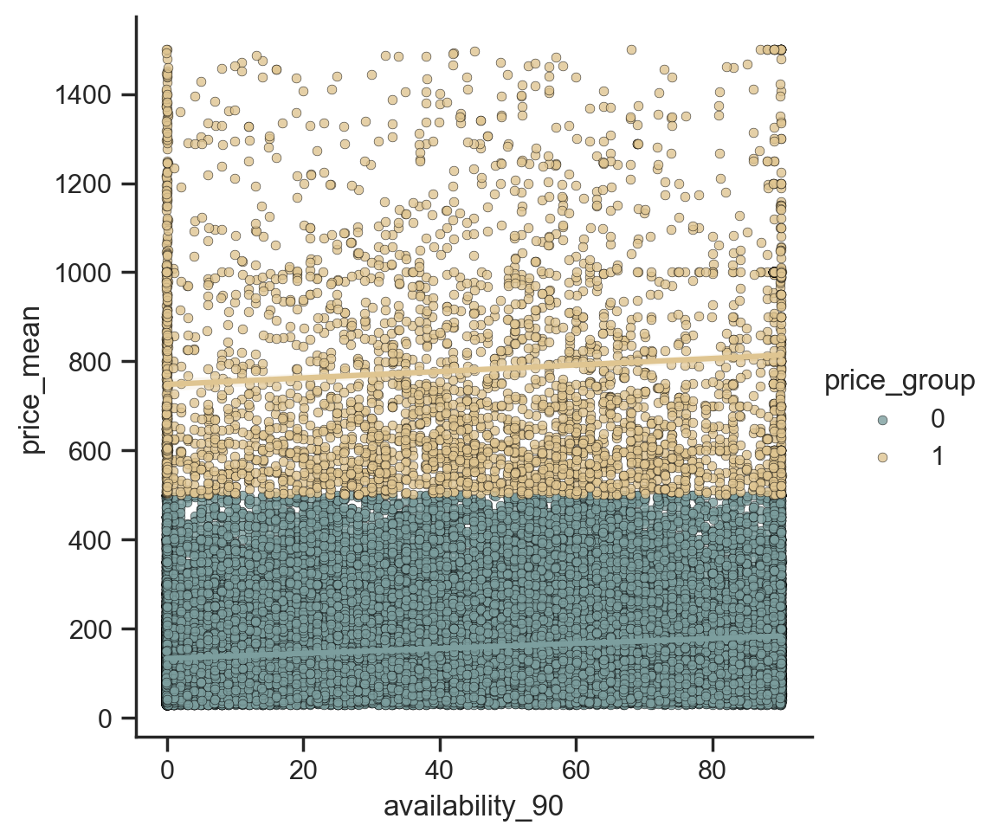

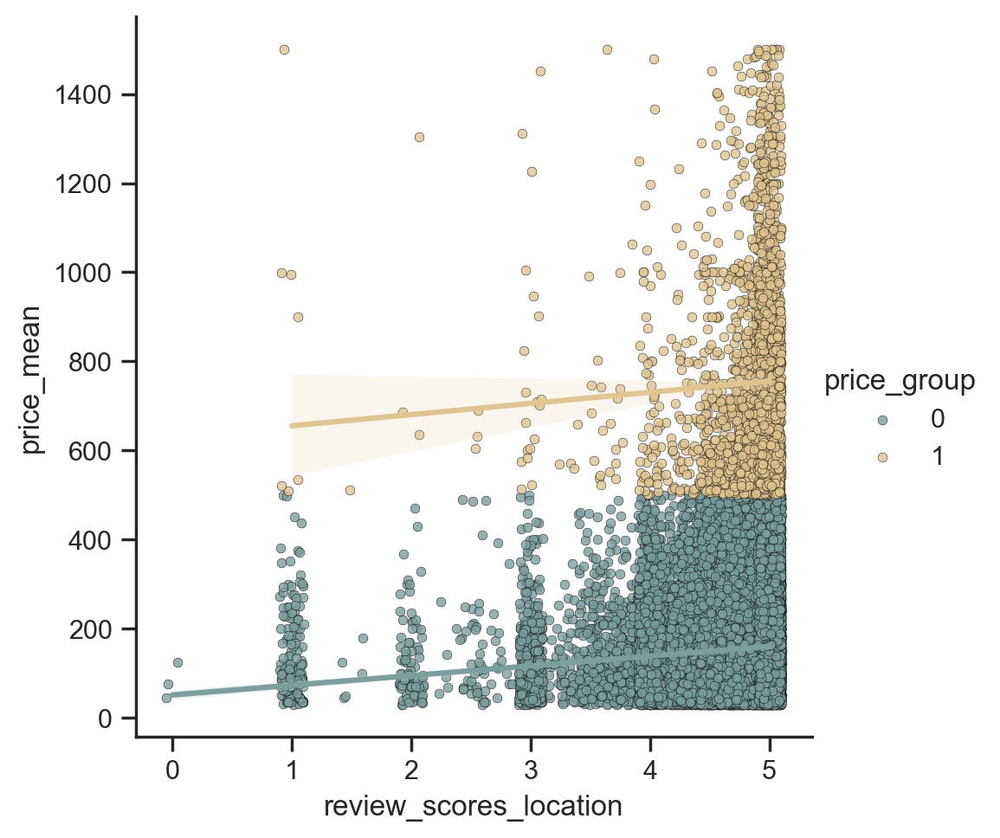

In [50]:
# Does features have a linear relationship with price ?

listing_clean['price_group'] = np.where(listing_clean['price_mean'] <= 500, 0, 1)
sns.set(style='ticks')
x_vars = numerical_features

for col in x_vars:
    sns.lmplot(data=listing_clean, x=col, y='price_mean', hue='price_group', x_jitter=0.1, palette=[BASE_COLOR, BASE_COMPLIMENTARY], 
               scatter_kws={'s':15, 'edgecolor':'black', 'linewidths':0.2})

plt.show()

# reset default plot formatting back as PairGrid change the defaults somehow
BASE_COLOR, BASE_HIGHLIGHT_INTENSE, BASE_HIGHLIGHT, BASE_COMPLEMENTRY, BASE_GREY, BASE_COLOR_ARR, BASE_COLOR_DEP, SYMBOLS = vs.set_plot_defaults()

>**Observation:** A linear relationship can be obsersved in most cases, however the slop of the fit changes for prices below and above £500, especially for number of bedrooms, bathrooms and number of people that can be accommodated.

<a id='multivariate'></a>
<span style="color:blue; font-size:30px; line-height:40px; font-family: Calibri;">Multivariate Analysis</span>

### Interaction analysis

Does features like neighbourhood and room type change the relationship some features have with price ?

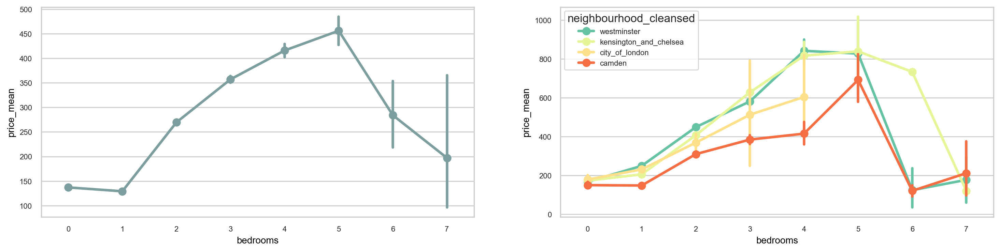

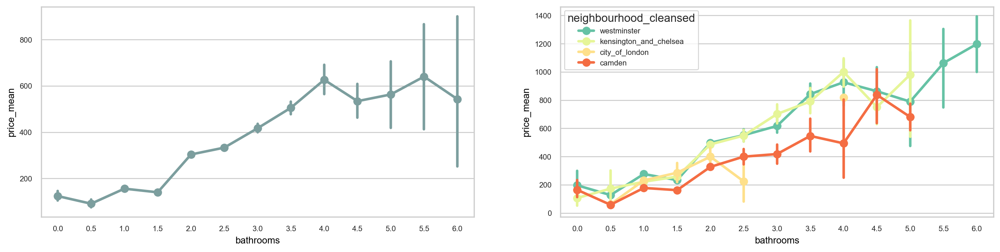

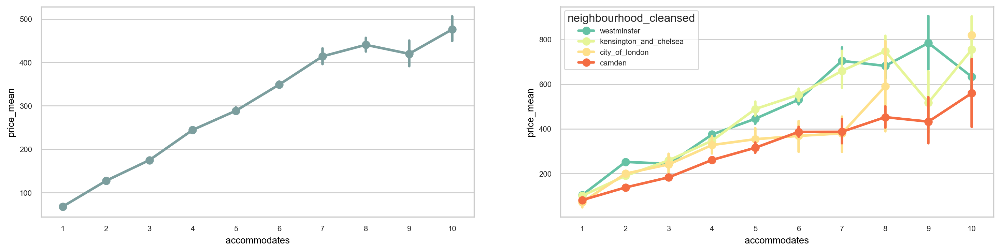

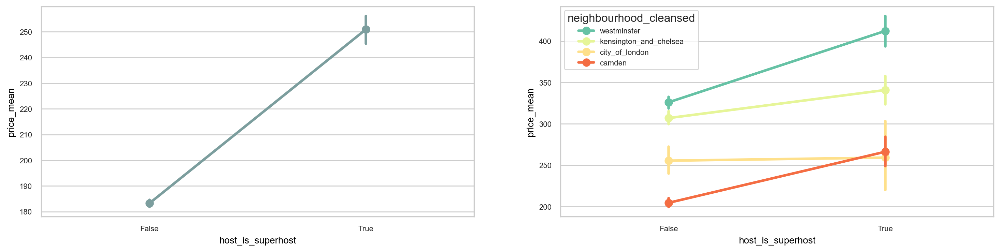

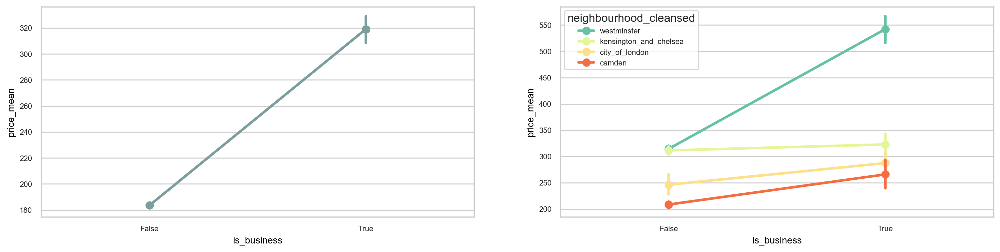

In [39]:
# Interaction with neighbourhood
cat = listing_clean.groupby('neighbourhood_cleansed')['price_mean'].mean().sort_values(ascending=False)
hue_order = list(cat.index)

for col in ['bedrooms', 'bathrooms', 'accommodates', 'host_is_superhost', 'is_business']:          

    plt.figure(figsize=(18,4))
    plt.subplot(1,2,1)
    sns.pointplot(data=listing_clean, x=col, y="price_mean",  color=BASE_COLOR)

    plt.subplot(1,2,2)
    sns.pointplot(data=listing_clean, x=col, y="price_mean", hue='neighbourhood_cleansed', hue_order=hue_order[:4], 
                  palette='Spectral_r')
    
plt.suptitle('Does features have a linear relationship with price ?')  

>**Observation:** There are indeed a lot of interactions introduced when we add features like neighbourhood and room type. Linear regression patterns can be observed, but the slope of the lines are changing

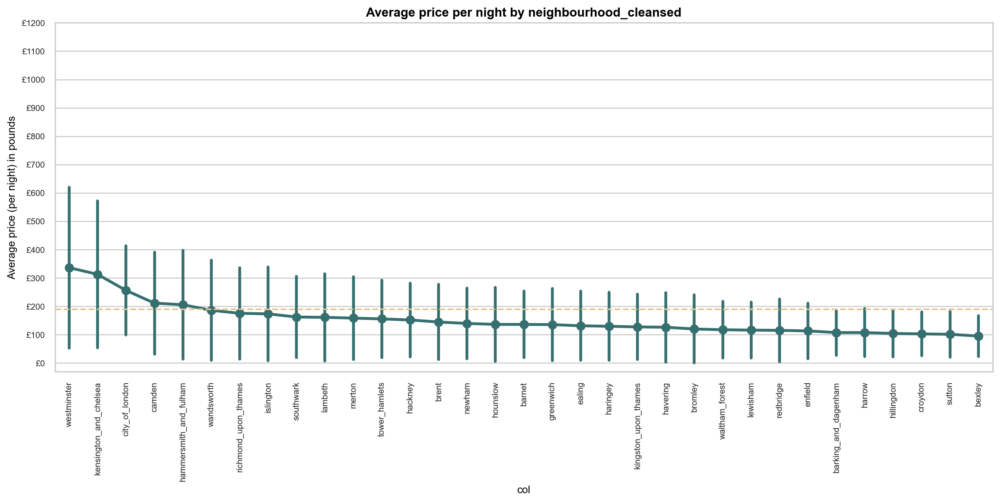

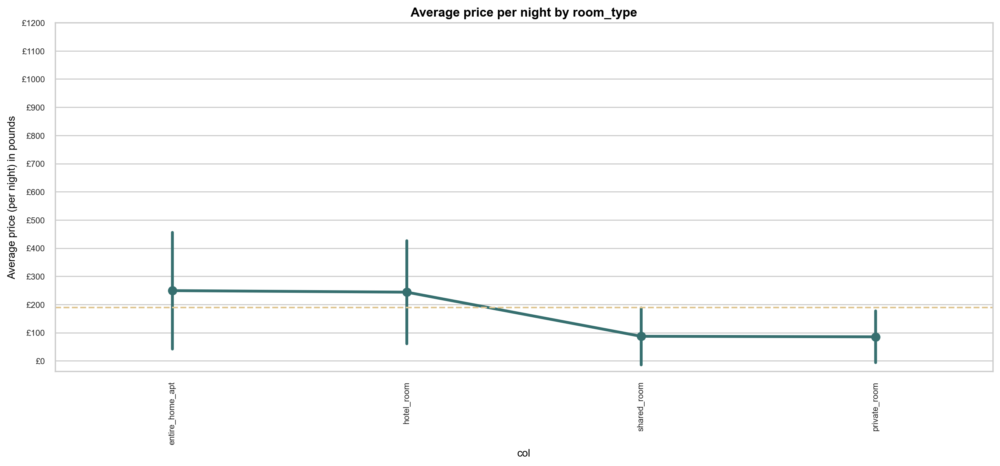

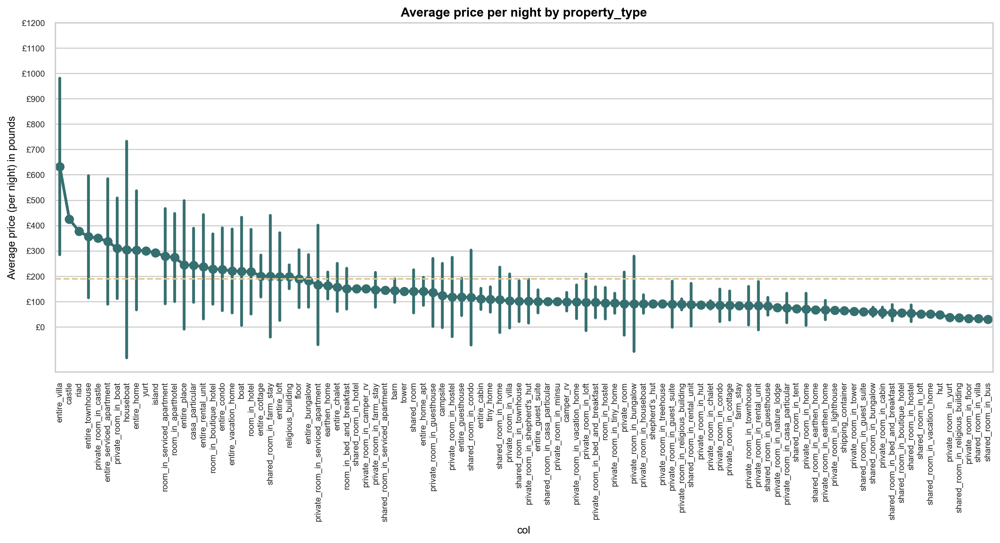

In [40]:
def custom(y, **kwargs):
    ym = y.mean()
    plt.axhline(ym, color=BASE_COMPLIMENTARY, linestyle="dashed")
    plt.annotate(f"mean: £{y.mean():.0f}", xy=(1,ym), 
                 xycoords=plt.gca().get_yaxis_transform(), ha="right", fontsize=12, color='r')


for col in ['neighbourhood_cleansed', 'room_type', 'property_type']:

    avg_price = listing_clean['price_mean'].mean()
    cat = listing_clean.groupby(col)['price_mean'].mean().sort_values(ascending=False)
    order = list(cat.index)

    plt.figure(figsize=(16,6))
    ax = sns.pointplot(data=listing_clean, x=col, y='price_mean', errorbar='sd', marker='o', order=order, color=BASE_HIGHLIGHT_INTENSE)

    ax.axhline(avg_price, color=BASE_COMPLIMENTARY, linestyle="dashed")    
    
    
    plt.title('Average price per night by {}'.format(col))
    plt.ylabel('Average price (per night) in pounds')
    plt.xlabel('col')

    plt.xticks(rotation=90)
    yticks = np.arange(0, 1300, 100)
    ylabels = ['£{:1.0f}'.format(tick) for tick in yticks] 
    plt.yticks(yticks, ylabels)

    plt.show()

>**Observation:** 
>- Neighbourhood 
>  - There's a constant variation in price between neighbourhoods, however more variation are observed in `Westminster` and `Kensington and Chelsea`
>  - Only the top 6 neighbourhoods show mean prices of above £200 per night, all other neighbourhoods have prices below £200
>  
>- Room type
>  - Entire homes and hotels show mean prices of above £200 per night, all other room types have prices below £200
>   
>- Property type
>  - Around 10 property types have extreme mean prices above £300 per night, with lots of variabilty like entire villas and townhouses
   

### Let's explore a bit deeper the relationship between price and each type of room

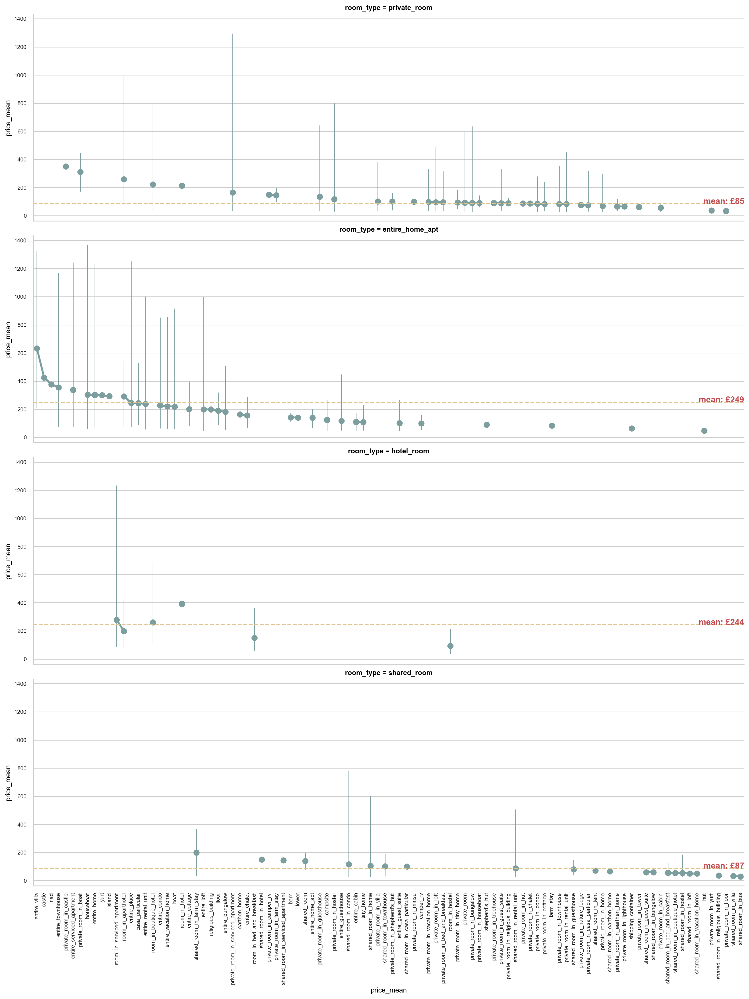

In [41]:
# reset default plot formatting back as PairGrid change the defaults somehow
BASE_COLOR, BASE_HIGHLIGHT_INTENSE, BASE_HIGHLIGHT, BASE_COMPLEMENTRY, BASE_GREY, BASE_COLOR_ARR, BASE_COLOR_DEP, SYMBOLS = vs.set_plot_defaults()


def custom(y, **kwargs):
    ym = y.mean()
    plt.axhline(ym, color=BASE_COMPLIMENTARY, linestyle="dashed")
    plt.annotate(f"mean: £{y.mean():.0f}", xy=(1,ym), 
                 xycoords=plt.gca().get_yaxis_transform(), ha="right", fontsize=12, color='r', weight='bold')

g = sns.FacetGrid(data = listing_clean, row = 'room_type', height=5, aspect=3, sharex=True, sharey=True) 
g.map(sns.pointplot, 'property_type', 'price_mean', order=order, errorbar=('pi', 97.5), seed=88, linestyles=None, 
      err_kws={'linewidth': 1}, color=BASE_COLOR)

g = g.map(custom, 'price_mean')

plt.xticks(rotation=90)
plt.tight_layout()

>**Observation**:
>- Hotel rooms and entire homes or apartments show prices above £200 per night, whilst shared rooms and private rooms show prices below £100 per night

<a id='clustering'></a>
## Let's use clustering to build a better price grouping

We have over 80 property types which could make the model after one-hot encoding too complex and cause overfitting. 
We could use room type instead, but this has only 4 categories with so much variation in price, it's too simple for modelling. 

- Let's use both room type and property type, but cluster it for simplification.
- Lets minimize the interacts location, room type and property type brings, whilst getting rid of some of relations between independent features like room type and property type

In [51]:
# encode categorical variables first before clustering

X_property = listing_clean[['room_type', 'property_type', 'latitude', 'longitude', 'price_mean']].copy(deep=True)

onehot = Pipeline(steps=[
    ('one-hot', OneHotEncoder(handle_unknown='ignore', sparse_output=False, dtype='int'))])

onehot_preprocessor = ColumnTransformer(transformers=[
    ('category', onehot, ['property_type', 'room_type']),
], 
        verbose_feature_names_out=False, 
        remainder = 'passthrough'                                                         
)

_ = onehot_preprocessor.fit(X_property).set_output(transform="pandas") 

X_property_transformed = onehot_preprocessor.transform(X_property)
X_property_transformed.head(2)

,property_type_barn,property_type_boat,property_type_camper_rv,property_type_campsite,property_type_casa_particular,property_type_castle,property_type_earthen_home,property_type_entire_bungalow,property_type_entire_cabin,property_type_entire_chalet,property_type_entire_condo,property_type_entire_cottage,property_type_entire_guest_suite,property_type_entire_guesthouse,property_type_entire_home,property_type_entire_home_apt,property_type_entire_loft,property_type_entire_place,property_type_entire_rental_unit,property_type_entire_serviced_apartment,property_type_entire_townhouse,property_type_entire_vacation_home,property_type_entire_villa,property_type_farm_stay,property_type_floor,property_type_houseboat,property_type_hut,property_type_island,property_type_private_room,property_type_private_room_in_bed_and_breakfast,property_type_private_room_in_boat,property_type_private_room_in_bungalow,property_type_private_room_in_cabin,property_type_private_room_in_camper_rv,property_type_private_room_in_casa_particular,property_type_private_room_in_castle,property_type_private_room_in_chalet,property_type_private_room_in_condo,property_type_private_room_in_cottage,property_type_private_room_in_earthen_home,property_type_private_room_in_farm_stay,property_type_private_room_in_floor,property_type_private_room_in_guest_suite,property_type_private_room_in_guesthouse,property_type_private_room_in_home,property_type_private_room_in_hostel,property_type_private_room_in_houseboat,property_type_private_room_in_hut,property_type_private_room_in_lighthouse,property_type_private_room_in_loft,property_type_private_room_in_minsu,property_type_private_room_in_nature_lodge,property_type_private_room_in_religious_building,property_type_private_room_in_rental_unit,property_type_private_room_in_serviced_apartment,property_type_private_room_in_shepherd's_hut,property_type_private_room_in_tiny_home,property_type_private_room_in_tower,property_type_private_room_in_townhouse,property_type_private_room_in_treehouse,property_type_private_room_in_vacation_home,property_type_private_room_in_villa,property_type_private_room_in_yurt,property_type_religious_building,property_type_riad,property_type_room_in_aparthotel,property_type_room_in_bed_and_breakfast,property_type_room_in_boutique_hotel,property_type_room_in_hostel,property_type_room_in_hotel,property_type_room_in_serviced_apartment,property_type_shared_room,property_type_shared_room_in_bed_and_breakfast,property_type_shared_room_in_boutique_hotel,property_type_shared_room_in_bungalow,property_type_shared_room_in_bus,property_type_shared_room_in_casa_particular,property_type_shared_room_in_condo,property_type_shared_room_in_earthen_home,property_type_shared_room_in_farm_stay,property_type_shared_room_in_guest_suite,property_type_shared_room_in_guesthouse,property_type_shared_room_in_home,property_type_shared_room_in_hostel,property_type_shared_room_in_hotel,property_type_shared_room_in_loft,property_type_shared_room_in_religious_building,property_type_shared_room_in_rental_unit,property_type_shared_room_in_serviced_apartment,property_type_shared_room_in_tent,property_type_shared_room_in_townhouse,property_type_shared_room_in_vacation_home,property_type_shared_room_in_villa,property_type_shepherd’s_hut,property_type_shipping_container,property_type_tiny_home,property_type_tower,property_type_yurt,room_type_entire_home_apt,room_type_hotel_room,room_type_private_room,room_type_shared_room,latitude,longitude,price_mean
listing_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
157714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,51.48974,-0.22208,70
13913,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

Let's use **gausian mixture model** algorithm to do clustering, as it will look for clusters that have a normal price distribution within each cluster, which will provide a better split

In [52]:
# Clustering
gmm = GaussianMixture(n_components=20, random_state=random_state, covariance_type='spherical', init_params='k-means++')
X_property_transformed['cluster'] = gmm.fit_predict(X_property_transformed)
X_property_transformed.head(2)

,property_type_barn,property_type_boat,property_type_camper_rv,property_type_campsite,property_type_casa_particular,property_type_castle,property_type_earthen_home,property_type_entire_bungalow,property_type_entire_cabin,property_type_entire_chalet,property_type_entire_condo,property_type_entire_cottage,property_type_entire_guest_suite,property_type_entire_guesthouse,property_type_entire_home,property_type_entire_home_apt,property_type_entire_loft,property_type_entire_place,property_type_entire_rental_unit,property_type_entire_serviced_apartment,property_type_entire_townhouse,property_type_entire_vacation_home,property_type_entire_villa,property_type_farm_stay,property_type_floor,property_type_houseboat,property_type_hut,property_type_island,property_type_private_room,property_type_private_room_in_bed_and_breakfast,property_type_private_room_in_boat,property_type_private_room_in_bungalow,property_type_private_room_in_cabin,property_type_private_room_in_camper_rv,property_type_private_room_in_casa_particular,property_type_private_room_in_castle,property_type_private_room_in_chalet,property_type_private_room_in_condo,property_type_private_room_in_cottage,property_type_private_room_in_earthen_home,property_type_private_room_in_farm_stay,property_type_private_room_in_floor,property_type_private_room_in_guest_suite,property_type_private_room_in_guesthouse,property_type_private_room_in_home,property_type_private_room_in_hostel,property_type_private_room_in_houseboat,property_type_private_room_in_hut,property_type_private_room_in_lighthouse,property_type_private_room_in_loft,property_type_private_room_in_minsu,property_type_private_room_in_nature_lodge,property_type_private_room_in_religious_building,property_type_private_room_in_rental_unit,property_type_private_room_in_serviced_apartment,property_type_private_room_in_shepherd's_hut,property_type_private_room_in_tiny_home,property_type_private_room_in_tower,property_type_private_room_in_townhouse,property_type_private_room_in_treehouse,property_type_private_room_in_vacation_home,property_type_private_room_in_villa,property_type_private_room_in_yurt,property_type_religious_building,property_type_riad,property_type_room_in_aparthotel,property_type_room_in_bed_and_breakfast,property_type_room_in_boutique_hotel,property_type_room_in_hostel,property_type_room_in_hotel,property_type_room_in_serviced_apartment,property_type_shared_room,property_type_shared_room_in_bed_and_breakfast,property_type_shared_room_in_boutique_hotel,property_type_shared_room_in_bungalow,property_type_shared_room_in_bus,property_type_shared_room_in_casa_particular,property_type_shared_room_in_condo,property_type_shared_room_in_earthen_home,property_type_shared_room_in_farm_stay,property_type_shared_room_in_guest_suite,property_type_shared_room_in_guesthouse,property_type_shared_room_in_home,property_type_shared_room_in_hostel,property_type_shared_room_in_hotel,property_type_shared_room_in_loft,property_type_shared_room_in_religious_building,property_type_shared_room_in_rental_unit,property_type_shared_room_in_serviced_apartment,property_type_shared_room_in_tent,property_type_shared_room_in_townhouse,property_type_shared_room_in_vacation_home,property_type_shared_room_in_villa,property_type_shepherd’s_hut,property_type_shipping_container,property_type_tiny_home,property_type_tower,property_type_yurt,room_type_entire_home_apt,room_type_hotel_room,room_type_private_room,room_type_shared_room,latitude,longitude,price_mean,cluster
listing_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
157714,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,51.48974,-0.22208,70,7
13913,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [53]:
# display the min/max prices for each cluster to check if the price groups make sense
tmp = X_property_transformed.groupby('cluster').agg(min=('price_mean', 'min'), max=('price_mean', 'max')).sort_values(by='min')
tmp['rank'] = tmp['min'].rank(method='max').astype('int')
tmp

,min,max,rank
cluster,,,
2,30,62,1
7,63,91,2
12,92,126,3
5,127,166,4
0,167,205,5
17,206,236,6
9,237,270,7
18,271,312,8
4,313,365,9


In [54]:
# resquence the cluster names by price
mymap = pd.Series(tmp['rank'].values,index=tmp.index).to_dict()
mymap

{2: 1,
 7: 2,
 12: 3,
 5: 4,
 0: 5,
 17: 6,
 9: 7,
 18: 8,
 4: 9,
 13: 10,
 6: 11,
 10: 12,
 1: 13,
 19: 14,
 15: 15,
 11: 16,
 3: 17,
 16: 18,
 8: 19,
 14: 20}

In [55]:
# rename clusters 
X_property_transformed['property_cluster'] = X_property_transformed['cluster'].map(mymap)

In [56]:
# add cluster to main dataset and double check correctness
listing_clean['property_cluster'] = X_property_transformed['property_cluster']
listing_clean.head()

,host_is_superhost,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,price_mean,private_bathroom,host_same_location,is_business,availability_90,neighbourhood_cleansed,property_type,room_type,review_scores_location,latitude,longitude,price_group,property_cluster
listing_id,,,,,,,,,,,,,,,,,,,,
157714,False,3,1,1.5,4,1,12,70,True,True,False,67,hammersmith_and_fulham,private_room_in_townhouse,private_room,4.76,51.48974,-0.22208,0,2
13913,False,1,1,1.0,1,2,14,79,False,True,False,78,islington,private_room_in_rental_unit,private_room,4.69,51.56861,-0.11270,0,2
15400,False,2,1,1.0,7,1,14,107,True,True,False,2,kensington_and_chelsea,entire_rental_unit,entire_home_apt,4.93,51.48780,-0.16813,0,3
306333,False,5,2,1.0,2,1,11,198,True,False,False,4,hackney,entire_rental_unit,entire_home_apt,4.89,51.52748,-0.08172,0,5
159736,False,2,1,1.0,4,4,12,62,False,False,False,2,lambeth,private_room_in_rental_unit,private_room,4.34,51.46788,-0.09993,0,1


### Let's use spatial analysis to visualize average prices in neighbourhoods more clearly

In [57]:
# make a geo spatial dataset with listing locations
cols = ['latitude', 'longitude', 'price_mean', 'property_cluster', 'neighbourhood_cleansed']
listings_geo = listing_clean[cols].copy(deep=True)
listings_geo.rename(columns={'neighbourhood_cleansed': 'neighbourhood'}, inplace=True)
listings_geo.head()

,latitude,longitude,price_mean,property_cluster,neighbourhood
listing_id,,,,,
157714,51.48974,-0.22208,70,2,hammersmith_and_fulham
13913,51.56861,-0.11270,79,2,islington
15400,51.48780,-0.16813,107,3,kensington_and_chelsea
306333,51.52748,-0.08172,198,5,hackney
159736,51.46788,-0.09993,62,1,lambeth


In [58]:
# make geometry field
listings_geo['geometry'] = listings_geo.apply(lambda x: Point((x.longitude, x.latitude)), axis=1)
type(listings_geo)

pandas.core.frame.DataFrame

In [59]:
listings_geo = gpd.GeoDataFrame(listings_geo, crs=crs_4326, geometry=listings_geo.geometry)
listings_geo.head()

,latitude,longitude,price_mean,property_cluster,neighbourhood,geometry
listing_id,,,,,,
157714,51.48974,-0.22208,70,2,hammersmith_and_fulham,POINT (-0.222080000000000 51.489739999999998)
13913,51.56861,-0.11270,79,2,islington,POINT (-0.112700000000000 51.568610000000000)
15400,51.48780,-0.16813,107,3,kensington_and_chelsea,POINT (-0.168130000000000 51.487800000000000)
306333,51.52748,-0.08172,198,5,hackney,POINT (-0.081720000000000 51.527479999999997)
159736,51.46788,-0.09993,62,1,lambeth,POINT (-0.099930000000000 51.467880000000001)


In [60]:
# calculate average price per neighborhood
neigborhood_price = listings_geo.groupby('neighbourhood', as_index=False)['price_mean'].mean()

In [61]:
neighbourhood = neighbourhood.merge(neigborhood_price, on='neighbourhood')
neighbourhood.head()

,neighbourhood,neighbourhood_group,geometry,price_mean
0,kingston_upon_thames,None,MULTIPOLYGON (((-0.330679000000000 51.32901100...,127.436293
1,croydon,None,MULTIPOLYGON (((-0.064021000000000 51.31863800...,102.708042
2,bromley,None,MULTIPOLYGON (((0.012131000000000 51.299599000...,120.061017
3,hounslow,None,MULTIPOLYGON (((-0.244562000000000 51.48870200...,136.378705
4,ealing,None,MULTIPOLYGON (((-0.411833000000000 51.53408400...,131.304729


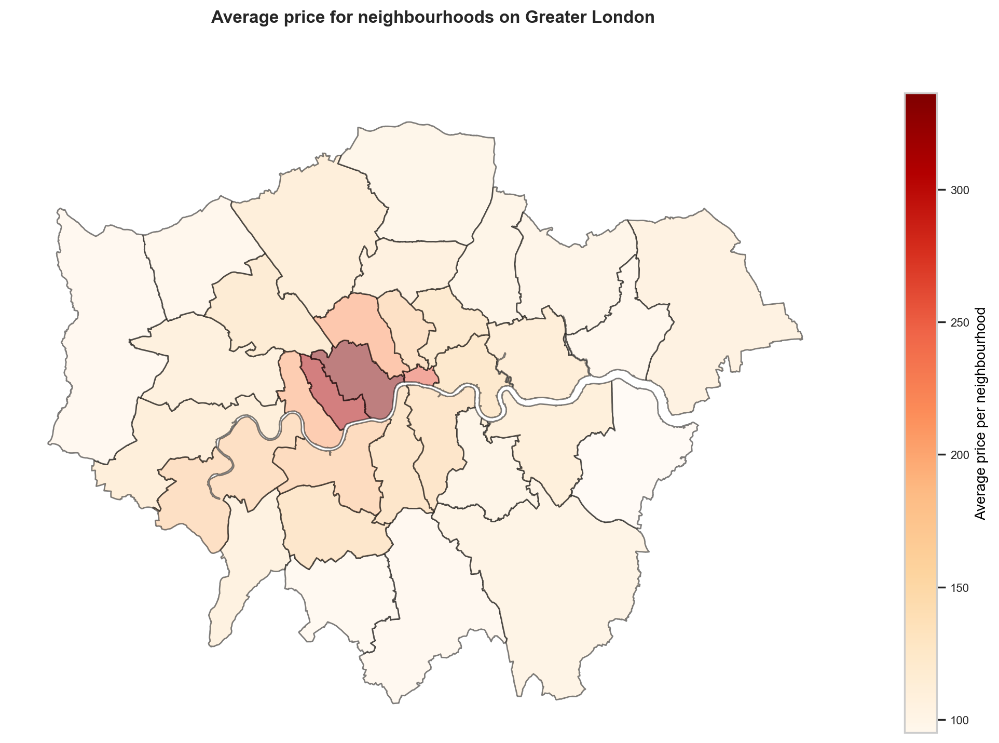

In [62]:
fig, ax = plt.subplots(1, 1, figsize=(16,8))

lgnd_kwds = {'label': 'Average price per neighbourhood', 
             'orientation': 'vertical'}

base = neighbourhood.plot(ax=ax,
                        column='price_mean', 
                        edgecolor='black',
                        cmap='OrRd', 
                        alpha=0.5,
                        zorder=1,                       
                        legend=True, 
                        legend_kwds=lgnd_kwds)

base.set_axis_off();

plt.suptitle('Average price for neighbourhoods on Greater London', fontsize=12)
plt.show()

>**Observation**:
>- The closer we get to the centre of Greater London, the more expensive it gets

###### Visualize the new property  clusters

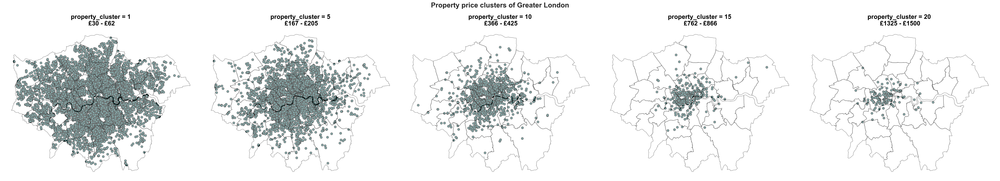

In [63]:
def spatial_mapping(data, color):
    price_min = data.price_mean.min()
    price_max = data.price_mean.max()
    ax=plt.gca()
    base = data.plot(ax=plt.gca(), zorder=1, marker='o', markersize=40, edgecolor="black", linewidth=1, color=BASE_HIGHLIGHT_INTENSE) 
    neighbourhood.plot(color='white', edgecolor='black', zorder=2, alpha=0.4, ax=base)
    base.set_axis_off()
    new_title = ax.get_title() + '\n £{} - £{}'.format(price_min, price_max)
    ax.set_title(new_title, fontsize='18')

g = sns.FacetGrid(data=listings_geo, col = 'property_cluster', col_order=[1, 5, 10, 15, 20], height=8, aspect=1)
g.map_dataframe(spatial_mapping)

plt.suptitle('Property price clusters of Greater London', fontsize=20)
plt.tight_layout()

>**Observation**:
>- We have perfect clusters. Cluster 1 contains budget accommodation which can be found all over greater London. As the cluster number increase, prices becomes more expensive, and listings are more condensed around the centre. 

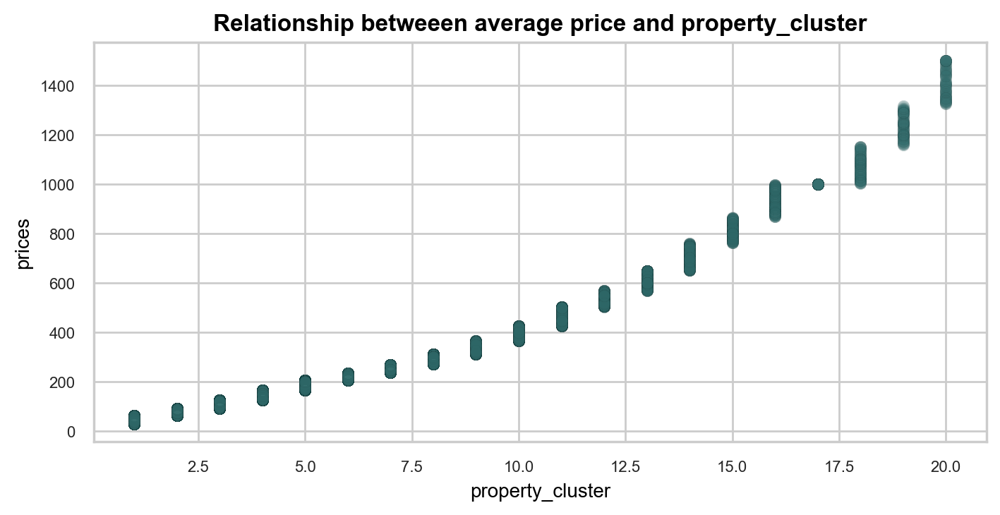

In [64]:
# analyse the relationship between the new property cluster and listing price
plt.figure(figsize=(20, 10))
for i, col in enumerate(['property_cluster']):
    plt.subplot(3, 3, i+1)
    sns.scatterplot(x=listing_clean[col], y=listing_clean['price_mean'], alpha=0.1, color=BASE_HIGHLIGHT_INTENSE, edgecolor='black', linewidth=0.05)
    plt.title('Relationship betweeen average price and {}'.format(col))
    plt.xlabel(col)
    plt.ylabel('prices')
plt.tight_layout()

>**Observation**:
>- The relationship are not perfect linear, this might cause some problems.  It's more a curvy shape, which could lean towards polynomical regression.
>- It's rare for properties to have prices over £500, it's more a luxury market, which might be the reason for the curve.

<a id='preprocessing'></a>
# Model preprocessing

In [65]:
# clear the garbage to free memory
gc.collect()

115683

Drop the fields no longer needed for modelling after clustering. Even though room type and location was used during clustering, we will still keep the room type and neighborhood features, to help the model identify the extreme budget and luxury fluctuations.

In [66]:
try:
    listing_clean = listing_clean.drop(['latitude', 'longitude', 'property_type', 'price_group'], axis=1)
except:
    pass

listing_clean.head(3)

,host_is_superhost,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,price_mean,private_bathroom,host_same_location,is_business,availability_90,neighbourhood_cleansed,room_type,review_scores_location,property_cluster
listing_id,,,,,,,,,,,,,,,,
157714,False,3,1,1.5,4,1,12,70,True,True,False,67,hammersmith_and_fulham,private_room,4.76,2
13913,False,1,1,1.0,1,2,14,79,False,True,False,78,islington,private_room,4.69,2
15400,False,2,1,1.0,7,1,14,107,True,True,False,2,kensington_and_chelsea,entire_home_apt,4.93,3


In [67]:
# split the datasets into dependent and independent datasets
y = listing_clean['price_mean'].copy()
X = listing_clean.drop('price_mean', axis=1)

In [68]:
# we want different preprocessing steps for numeric vs categorical features
numerical_features = X.select_dtypes(include='number').columns.tolist()   
print('Numerical features {}'.format(numerical_features))
categorical_features = X.select_dtypes(exclude='number').columns.tolist() 
print('Categorical features {}'.format(categorical_features)) 

Numerical features ['accommodates', 'bedrooms', 'bathrooms', 'minimum_minimum_nights', 'calculated_host_listings_count', 'host_years_active', 'availability_90', 'review_scores_location', 'property_cluster']
Categorical features ['host_is_superhost', 'private_bathroom', 'host_same_location', 'is_business', 'neighbourhood_cleansed', 'room_type']


As we will use cross validation in steps below, we want to avoid that each fold end up with different features when we drop sparse columns after one-hot encoding. We therefore do only the onehot encoding step before modelling, using the full datasets to ensure consistency.

In [69]:
# cleaning data / preprocessing step before we split out data into train/test
onehot_pipe = Pipeline(steps=[
    ('one-hot', OneHotEncoder(dtype='int', 
                              drop="if_binary", 
                              handle_unknown='infrequent_if_exist', 
                              sparse_output=False, 
                              min_frequency=25))   
])

onehot_preprocessor = ColumnTransformer(transformers=[
    ('category', onehot_pipe, categorical_features),
], 
        verbose_feature_names_out=False, 
        remainder = 'passthrough'                                                         
)

_ = onehot_preprocessor.fit(X).set_output(transform="pandas") 

In [70]:
X_transformed = onehot_preprocessor.transform(X)
X_transformed.head()

,host_is_superhost_True,private_bathroom_True,host_same_location_True,is_business_True,neighbourhood_cleansed_barking_and_dagenham,neighbourhood_cleansed_barnet,neighbourhood_cleansed_bexley,neighbourhood_cleansed_brent,neighbourhood_cleansed_bromley,neighbourhood_cleansed_camden,neighbourhood_cleansed_city_of_london,neighbourhood_cleansed_croydon,neighbourhood_cleansed_ealing,neighbourhood_cleansed_enfield,neighbourhood_cleansed_greenwich,neighbourhood_cleansed_hackney,neighbourhood_cleansed_hammersmith_and_fulham,neighbourhood_cleansed_haringey,neighbourhood_cleansed_harrow,neighbourhood_cleansed_havering,neighbourhood_cleansed_hillingdon,neighbourhood_cleansed_hounslow,neighbourhood_cleansed_islington,neighbourhood_cleansed_kensington_and_chelsea,neighbourhood_cleansed_kingston_upon_thames,neighbourhood_cleansed_lambeth,neighbourhood_cleansed_lewisham,neighbourhood_cleansed_merton,neighbourhood_cleansed_newham,neighbourhood_cleansed_redbridge,neighbourhood_cleansed_richmond_upon_thames,neighbourhood_cleansed_southwark,neighbourhood_cleansed_sutton,neighbourhood_cleansed_tower_hamlets,neighbourhood_cleansed_waltham_forest,neighbourhood_cleansed_wandsworth,neighbourhood_cleansed_westminster,room_type_entire_home_apt,room_type_hotel_room,room_type_private_room,room_type_shared_room,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,availability_90,review_scores_location,property_cluster
listing_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
157714,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,3,1,1.5,4,1,12,67,4.76,2
13913,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,1.0,1,2,14,78,4.69,2
15400,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,2,1,1.0,7,1,14,2,4.93,3
306333,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,5,2,1.0,2,1,11,4,4.89,5
159736,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,1,1.0,4,4,12,2,4.34,1


In [71]:
# is_business is imbalanced, and cause prices to be abnormally high

X_train, X_test, y_train, y_test = train_test_split(X_transformed, 
                                                    y, 
                                                    test_size=0.3, 
                                                    random_state=10, 
                                                    stratify=X['is_business'],
                                                   )

In [72]:
# pre-processing pipeline - scaling and impute data after splitting data into training and testing sets

numerical_preprocessor = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='median')),
    ('scale', StandardScaler())
])

preprocessor = ColumnTransformer(transformers=[

    ('number', numerical_preprocessor, numerical_features),
], 
        verbose_feature_names_out=False, 
        remainder = 'passthrough'                                                         
)

<a id='baseline'></a>
# Modelling Step 1 - Setting a baseline 

2 baseline models will be created, 1 with target log transformation to make the distribution normal, and 1 without

As we are observed lots of interactions during EDA in the data when we introduce features `neighbourhood` and `room_type`, we will use the Ridge algorithm with regularization to minimize the impact

In [73]:
# from sklearn.preprocessing import PolynomialFeatures
# from sklearn.pipeline import make_pipeline
# from sklearn.model_selection import cross_validate

# linear_regression = LinearRegression()

# poly_features = PolynomialFeatures(
#     degree=2, include_bias=False, interaction_only=True
# )
# linear_regression_interactions = make_pipeline(poly_features, 
#                                                linear_regression
#                                               ).set_output(transform="pandas")

# # solution
# cv_results = cross_validate(
#     linear_regression_interactions,
#     X_train,
#     y_train,
#     cv=10,
#     scoring="neg_root_mean_squared_error",
#     n_jobs=2,
# )

# print(
#     "Mean absolute error on testing set with interactions: "
#     f"{-cv_results['test_score'].mean():.3f} ± "
#     f"{cv_results['test_score'].std():.3f} g"
# )

In [74]:
# from sklearn.ensemble import RandomForestClassifier, VotingClassifier, VotingRegressor

# alphas = (0.001, 0.01, 0.1, 0.5, 0.9, 1.1, 1.5, 2, 2.5, 5, 10, 100)

# # Linear model 
# lr = LinearRegression()

# # ridge
# ridge = Ridge(alpha=1e-10)

# # ridge cv
# ridge_cv = RidgeCV(alphas)

# # Ensemble
# lr_xgb_rf = VotingRegressor(estimators=[('lr', lr), ('ridge', ridge), ('ridge_cv', ridge_cv)])

In [76]:
# As our base model, lets evaluate the performance of Ridge estimator with a very small alpha, with and without target log transformation

alpha_base=1e-10

# without target transformation
base_model = Pipeline(
    [
        ("preprocess", preprocessor),
        ('selector', VarianceThreshold(0)),
        ("base", Ridge(alpha_base)),                             
    ]
)

# with target transformation on log scale with base 10
base_model_with_log_target = Pipeline(
    [
        ("preprocess", preprocessor),
        ('selector', VarianceThreshold(0)),        
        ("base_transformed", TransformedTargetRegressor(regressor=Ridge(alpha_base), 
                                                        func=func,
                                                        inverse_func=inverse_func)),                     
    ]
)

In [77]:
_ = base_model.fit(X_train, y_train).set_output(transform="pandas")

In [78]:
_ = base_model_with_log_target.fit(X_train, y_train).set_output(transform="pandas")

## Evaluation: base model

In [79]:
# predict
y_train_preds = base_model.predict(X_train)
y_train_preds_transformed = base_model_with_log_target.predict(X_train)

In [80]:
# transform X_train
X_train_transformed = preprocessor.transform(X_train)
X_train_transformed.head(3)

,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,availability_90,review_scores_location,property_cluster,host_is_superhost_True,private_bathroom_True,host_same_location_True,is_business_True,neighbourhood_cleansed_barking_and_dagenham,neighbourhood_cleansed_barnet,neighbourhood_cleansed_bexley,neighbourhood_cleansed_brent,neighbourhood_cleansed_bromley,neighbourhood_cleansed_camden,neighbourhood_cleansed_city_of_london,neighbourhood_cleansed_croydon,neighbourhood_cleansed_ealing,neighbourhood_cleansed_enfield,neighbourhood_cleansed_greenwich,neighbourhood_cleansed_hackney,neighbourhood_cleansed_hammersmith_and_fulham,neighbourhood_cleansed_haringey,neighbourhood_cleansed_harrow,neighbourhood_cleansed_havering,neighbourhood_cleansed_hillingdon,neighbourhood_cleansed_hounslow,neighbourhood_cleansed_islington,neighbourhood_cleansed_kensington_and_chelsea,neighbourhood_cleansed_kingston_upon_thames,neighbourhood_cleansed_lambeth,neighbourhood_cleansed_lewisham,neighbourhood_cleansed_merton,neighbourhood_cleansed_newham,neighbourhood_cleansed_redbridge,neighbourhood_cleansed_richmond_upon_thames,neighbourhood_cleansed_southwark,neighbourhood_cleansed_sutton,neighbourhood_cleansed_tower_hamlets,neighbourhood_cleansed_waltham_forest,neighbourhood_cleansed_wandsworth,neighbourhood_cleansed_westminster,room_type_entire_home_apt,room_type_hotel_room,room_type_private_room,room_type_shared_room
listing_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
22567214,-1.185163,-0.524097,-0.560721,0.077641,-0.280862,-0.379850,-0.935264,-0.432782,-0.980684,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
18823071,-0.083238,-1.660930,-0.560721,-0.257474,-0.165891,0.234489,-0.966953,0.166502,-0.712188,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0
630426750119999330,-0.634200,-0.524097,0.307634,-0.145769,-0.300024,-1.608529,-0.301488,0.466144,0.093298,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0


### Mutual Information (MI) - Feature Importance

Mutual Information (MI) is a way to show how every feature interact with the target variable in this case 'price'. Here to interact means how a particular feature changes the target variable. 
Note: Mutual Information only works with numerical data

A higher value of MI means a closer connection between the feature and the target indicating feature importance for training the model. 
However, the lower the MI score like 0 indicates a weak connection between the feature and the target.

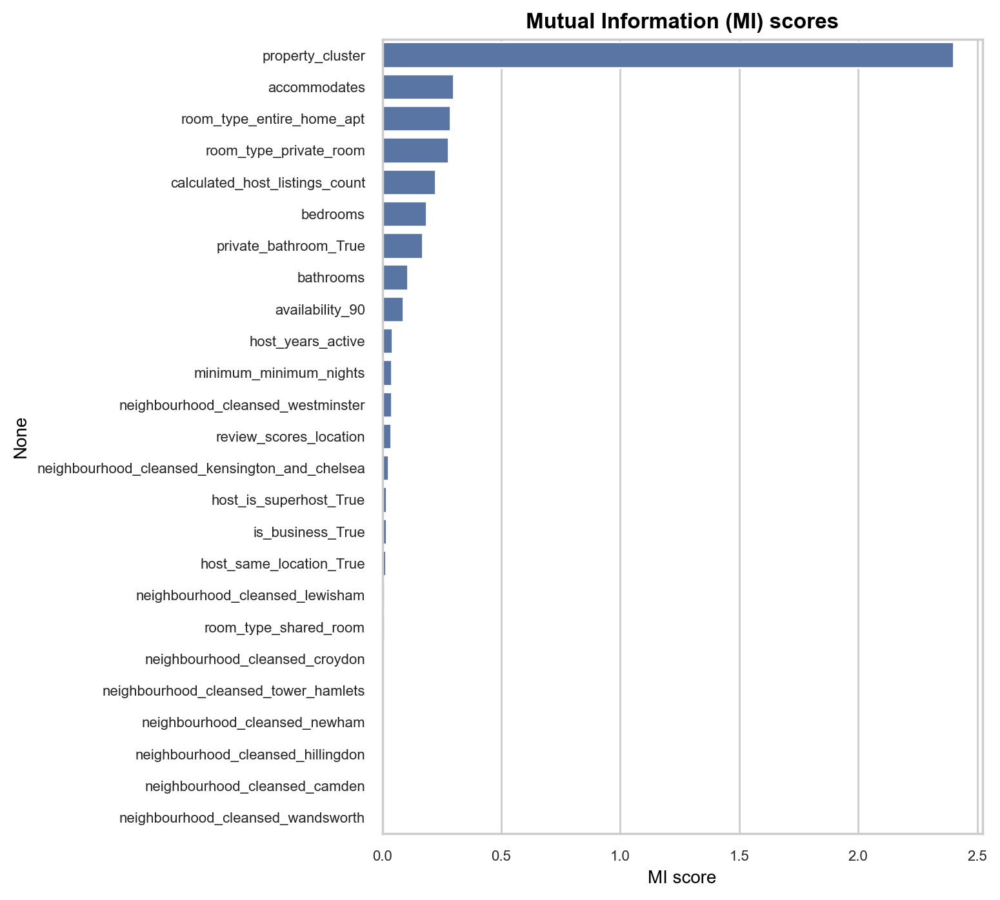

In [81]:
# display Mutual Information scores of the features
mi_score = get_mi_score(X_train_transformed, y_train)

# Show to 25 most important features
topn = 25
plt.figure(figsize=(6, 8))
ax = sns.barplot(y=mi_score.index[:topn], x=mi_score[:topn])
plt.xlabel('MI score')
ax.set_title('Mutual Information (MI) scores')
plt.show()

### Test for multicollinearity using Variance Inflation Factor (VIF)

Multicollinearity means, there are linear relationships or correlation between independent variables, which should not be the case for linear regression to be effective.

Typically, a variable with VIF greater than 5 indicates Multicollinearity.


In [82]:
# gather features
vip_features = " + ".join(X_train_transformed.columns)

In [83]:
# merge X and y as required by statsmodels
vip_df = X_train_transformed.merge(y_train, left_index=True, right_index=True)

In [84]:
sm_y, sm_X = dmatrices('price_mean ~' + vip_features, vip_df, return_type='dataframe')
vif = pd.DataFrame()
vif['VIF Factor'] = [variance_inflation_factor(sm_X.values, i) for i in range(sm_X.shape[1])]
vif['features'] = sm_X.columns
vif

/opt/anaconda3/envs/ds_udacity_projects/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1781: RuntimeWarning: divide by zero encountered in scalar divide
  return 1 - self.ssr/self.centered_tss
/opt/anaconda3/envs/ds_udacity_projects/lib/python3.10/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


,VIF Factor,features
0,0.000000,Intercept
1,3.203589,accommodates
2,2.938398,bedrooms
3,1.592348,bathrooms
4,1.035008,minimum_minimum_nights
5,1.270449,calculated_host_listings_count
6,1.146904,host_years_active
7,1.251693,availability_90
8,1.049009,review_scores_location
9,2.594181,property_cluster


>**Observation:** 
> - For VIF to be 'inf' means R2 must be 1. As the formula 1/1-R2, we end up dividing by 0, ending up with 'inf' values. It means we have high multicollinearity.
> - Lots of interactions between neighborhood and room type exist, ideally we should drop 1 of these variables. But as we are using ridge algorithm, lets observe how regularization can take care of this.
> - As `accommodates`, `bedrooms` and `bathrooms` have VIP below 5, I assume it's ok to keep all 3 variables|

### Plot model performance

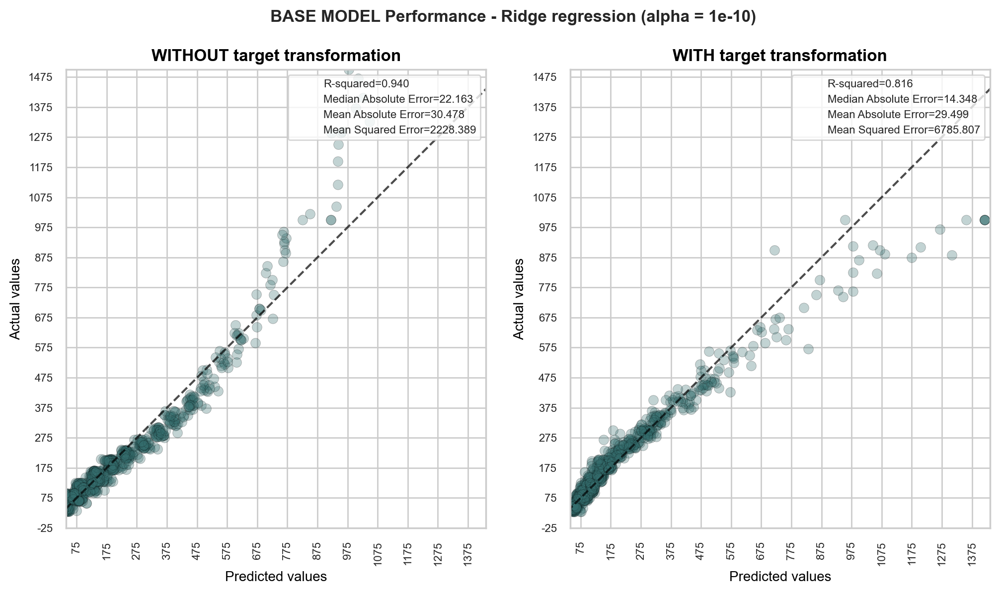

In [236]:
plot_model_performance_scatter(
    y_train, 
    y_train_preds, 
    y_train_preds_transformed, 
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='BASE MODEL Performance - Ridge regression (alpha = {})'.format(alpha_base),
    kind='actual_vs_predicted',  
    lower_lim=-25, 
    upper_lim=1500, 
    interval=100,
)

R-squared: 0.94
Mean Squared Error (MSE): 2228.39
Median Absolute Error: 22.16
Mean Absolute Error: 30.48
R-squared: 0.82
Mean Squared Error (MSE): 6785.81
Median Absolute Error: 14.35
Mean Absolute Error: 29.50


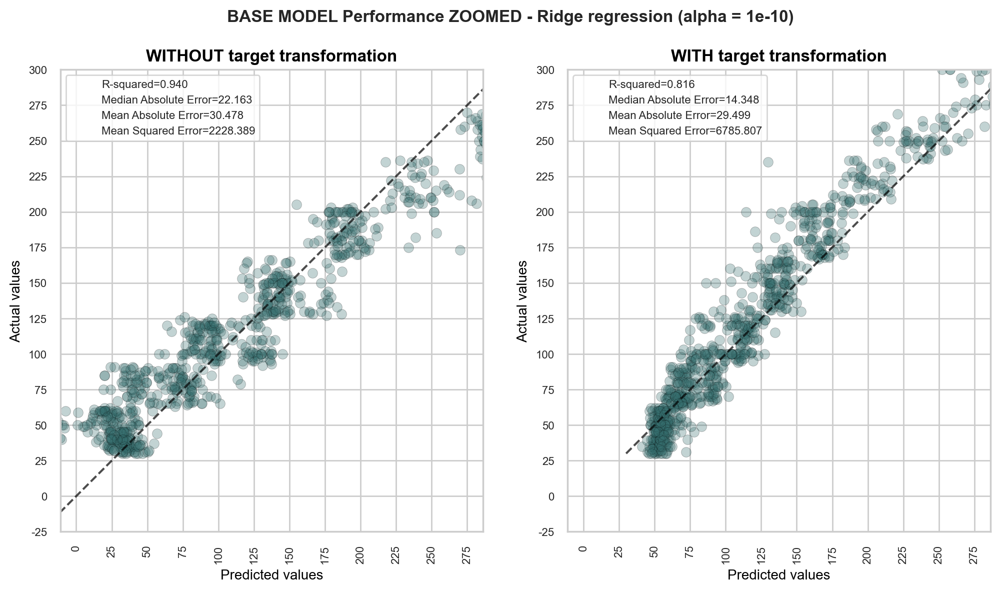

In [86]:
# Lets zoom a bit to the most likely price range, filtering the luxury listings out
plot_model_performance_scatter(
    y_train, 
    y_train_preds, 
    y_train_preds_transformed, 
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='BASE MODEL Performance ZOOMED - Ridge regression (alpha = {})'.format(alpha_base),
    kind='actual_vs_predicted',  
    lower_lim=-25, 
    upper_lim=300, 
    interval=25,
)

>**Observation:**
>   - Model without log transformation, are frequently underpredicting, and even comes up with negative price predictions. Overall prediction are better, which is quite strange ??!!
>   - Model with log transformation are doing excellent with most likely predictions between £100 - £500, but over predict outlier budget listings below £75 and luxury listings over £500 which gives it poorer overall scores

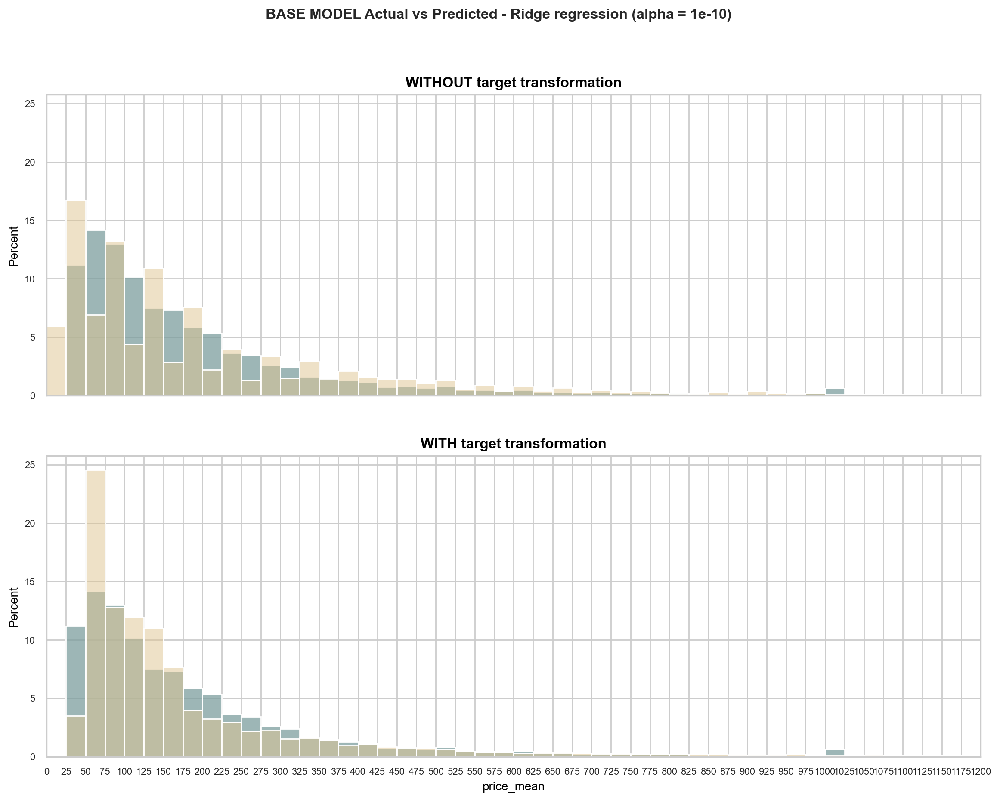

In [88]:
plot_model_performance_hist(
    y_train, 
    y_train_preds, 
    y_train_preds_transformed, 
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='BASE MODEL Actual vs Predicted - Ridge regression (alpha = {})'.format(alpha_base),
)

>**Observation:** Log transformed model shows a better prediction exponential shape. Overall the model is doing great, but overfits on budget listings below £75

### Linear Assumption Test: Normal distribution of residuals

Residuals should have a constant variance, with a mean around 0

/opt/anaconda3/envs/ds_udacity_projects/lib/python3.10/site-packages/statsmodels/stats/_adnorm.py:67: RuntimeWarning: divide by zero encountered in log1p
  s = np.sum((2 * i[sl1] - 1.0) / nobs * (np.log(z) + np.log1p(-z[sl2])),


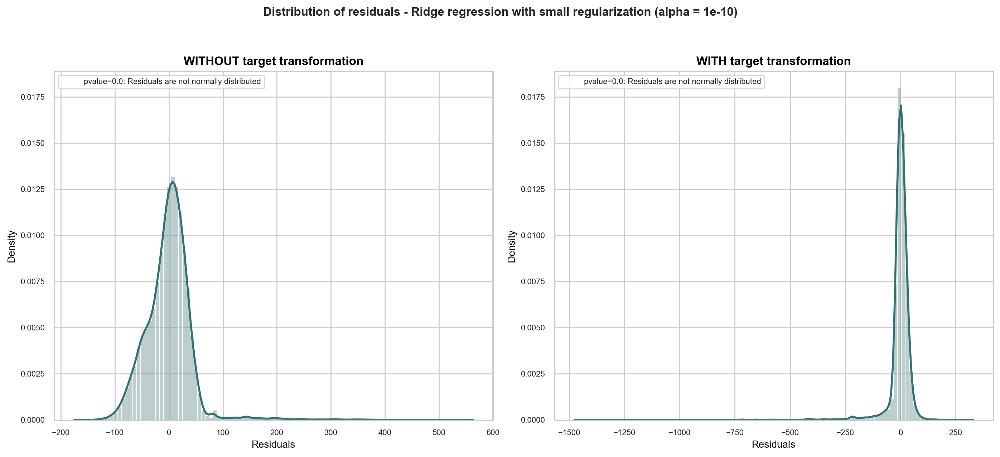

In [225]:
distribution_of_errors(
    model1=base_model,
    model2=base_model_with_log_target,
    X=X_train,
    y=y_train,
    kind='kde',
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='Distribution of residuals - Ridge regression with small regularization (alpha = {})'.format(alpha_base),
)

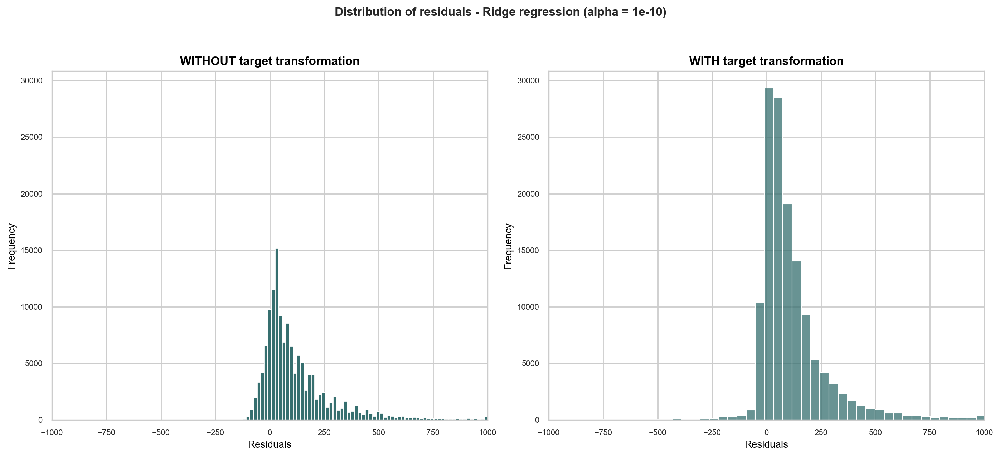

In [230]:
distribution_of_errors(
    model1=base_model,
    model2=base_model_with_log_target,
    X=X_train,
    y=y_train,
    kind='hist',
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='Distribution of residuals - Ridge regression (alpha = {})'.format(alpha_base),
)

>**Observation:** Log transformed model shows a bigger density around mean = 0, which is great, however the error range between 250 and -250 is bigger

### Linear Assumption Test: Homoscedasticity 

Residuals should have a constant variance, with a mean around 0

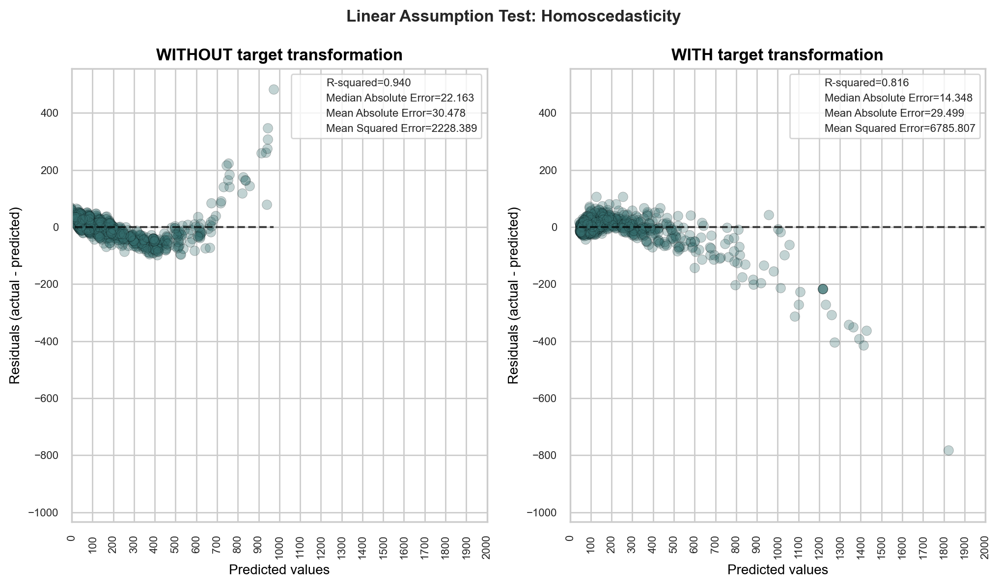

In [238]:
# Assumption #3: Homoscedasticity - residuals have a constant variance

plot_model_performance_scatter(
    y_train, 
    y_train_preds, 
    y_train_preds_transformed, 
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='Linear Assumption Test: Homoscedasticity',
    kind='residual_vs_predicted',  
    lower_lim=0, 
    upper_lim=2000, 
    interval=100,    
)

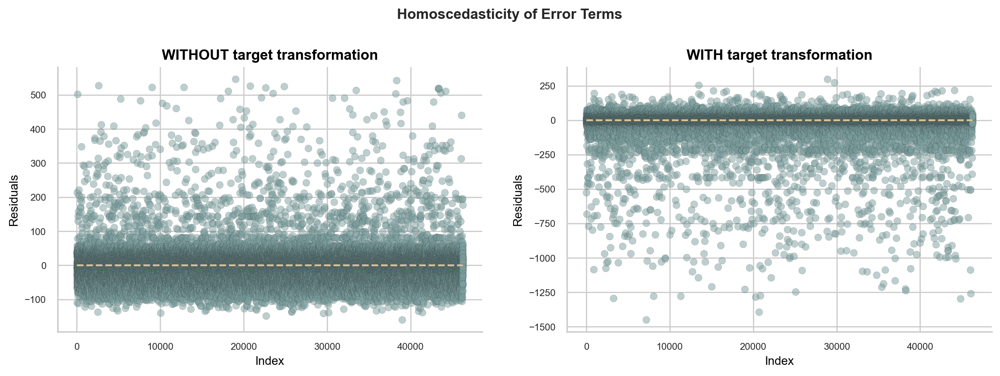

In [244]:
residual_variance(
    model1=base_model,
    model2=base_model_with_log_target,
    X=X_train,
    y=y_train,
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='Homoscedasticity of Error Terms',
    figsize=(14,4),
)

>**Observation:** Both models have a constant variance for most listings, however there are in both cases some outliers. The variance is bigger where the model was log transformed

### Model Coeffients

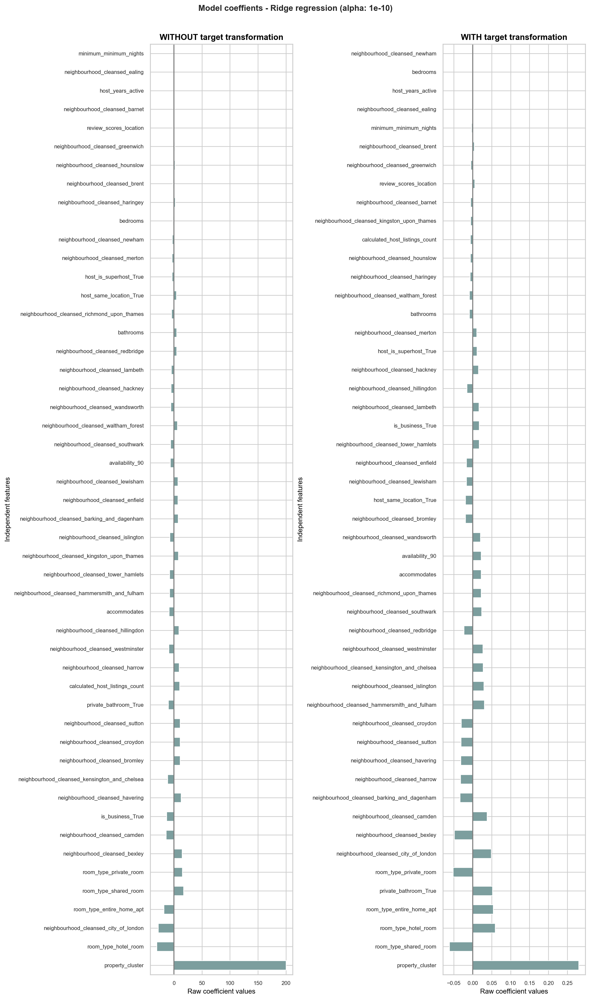

In [96]:
plot_coef(
    model1=base_model,
    model2=base_model_with_log_target,
    alpha=alpha_base,
    title1='WITHOUT target transformation',
    title2='WITH target transformation',
    suptitle='Model coeffients - Ridge regression',
)

The plot above tells us about dependencies between a specific feature and
the target when all other features remain constant, i.e., **conditional
dependencies**. 

<div class="alert alert-danger"><h4>Warning</h4>
<p>
Coeffients for model without log transformation makes little since. Intercept is high at £210 per night. 
An increase of ENTIRE HOMES will induce a decrease of the PRICE when all other features remain constant. 
On the contrary, an increase of the SHARED ROOMS will induce an increase of the PRICE when all other features remain constant.
This contradicts what we saw in exploratory analysis above.
    
</p></div>

Coeffients for model with log transformation looks better. Intercept seems reasonable at £114. We have positive coeffients for ENTIRE ROOMS and HOTELS, and negative coeffients for SHARED and PRIVATE rooms. It's strange how `accommodates` have such low importance.

### Variability of the coefficients

We can check the coefficient variability through cross-validation:
it is a form of data perturbation (related to
[resampling](https://en.wikipedia.org/wiki/Resampling_(statistics))).

If coefficients vary significantly when changing the input dataset
their robustness is not guaranteed, and they should probably be interpreted
with caution.

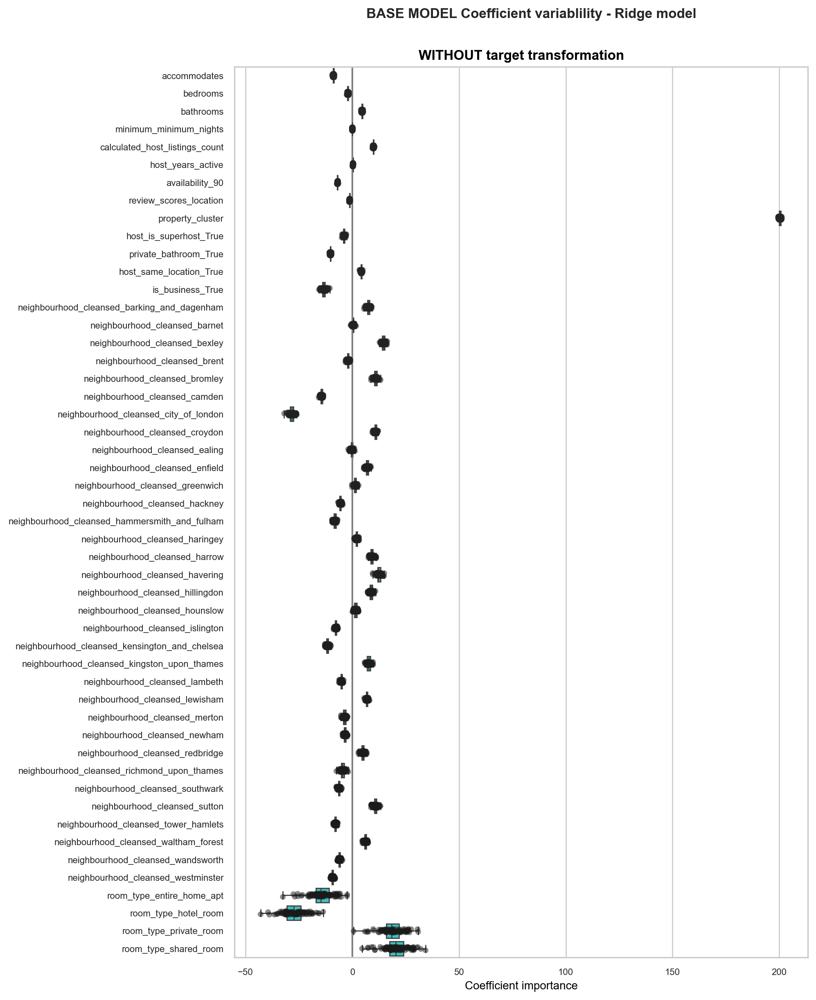

In [266]:
coefficient_variability(
    model=base_model, 
    X=X_train, 
    y=y_train, 
    alpha=alpha_base,
    title='WITHOUT target transformation',
    suptitle='BASE MODEL Coefficient variablility - Ridge model'
)

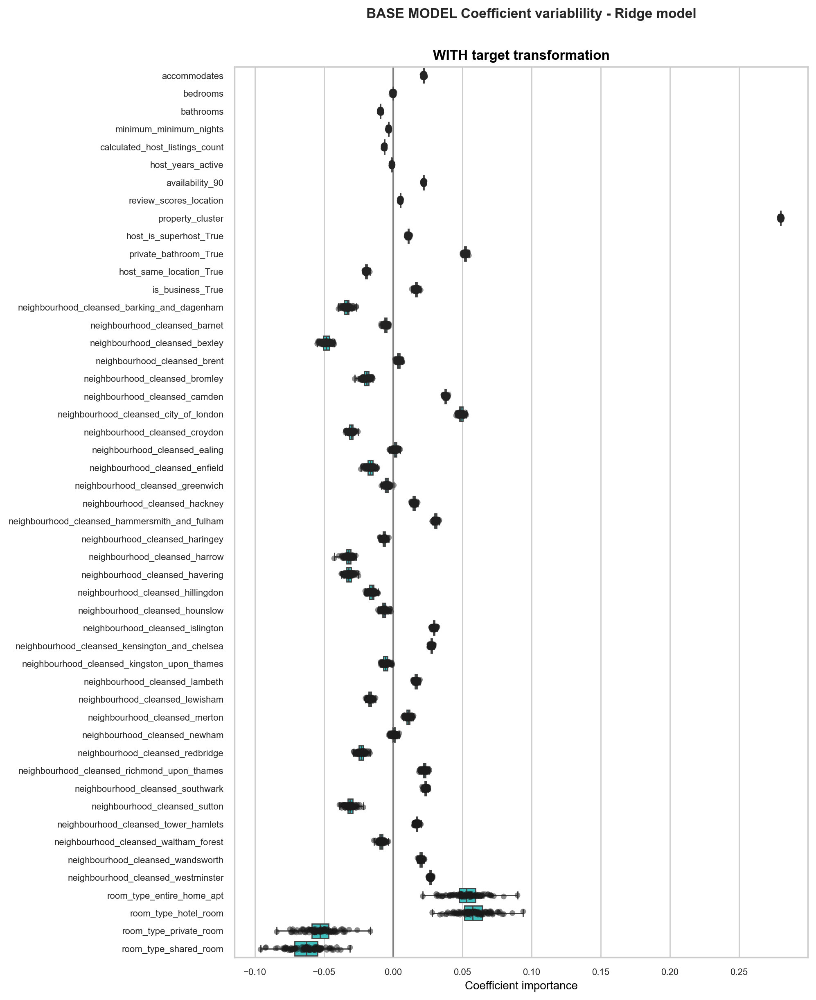

In [267]:
coefficient_variability(
    model=base_model_with_log_target, 
    X=X_train, 
    y=y_train, 
    alpha=alpha_base,
    title='WITH target transformation',
    suptitle='BASE MODEL Coefficient variablility - Ridge model',
    random_state=random_state
)

>**Observation**: We can observe high variability in room_type, and some minor variability in some neighbourhoods in both models

#### QQ plot (short for Quantile-Quantile)

As the name suggests, it depicts the quantiles of the observed distribution (residuals in this case) against the quantiles of a reference distribution, typically the standard normal distribution.

- We plot the quantiles of the two distributions against each other.
- Deviations from the straight line indicate a departure from the assumed distribution.


**A good QQ plot will:**

Show minimal deviations from the reference line, indicating that the residuals are approximately normally distributed.

**A bad QQ plot will:**

Exhibit significant deviations, indicating a departure from the normality of residuals.
Display patterns of skewness with its diverging ends, etc.

Thus, the more aligned the QQ plot looks, the more confident you can be about your model.

This is especially useful when the regression line is difficult to visualize, i.e., in a high-dimensional dataset.

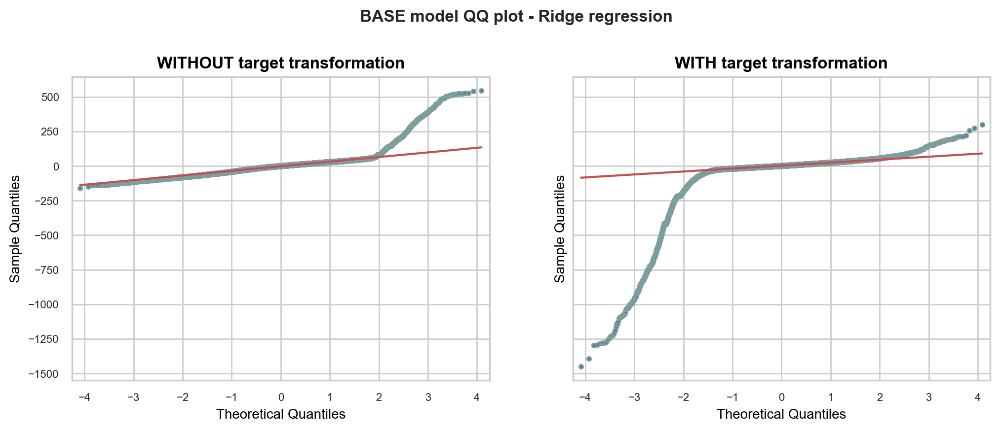

In [336]:
#QQ plot
compare_qqplot(
    base_model, 
    base_model_with_log_target, 
    X_train, 
    y_train, 
    title1='WITHOUT target transformation', 
    title2='WITH target transformation', 
    suptitle='BASE model QQ plot - Ridge regression',
    figsize=(12,4)
)

<a id='model_improve'></a>
# Modelling Step 2 - Using Ridge CV

Lets get rid of interactions, by increasing regularization

In [322]:
# modelling

# numpy.logspace(start, stop, num=50, endpoint=True, base=10.0, dtype=None, axis=0)

# alphas = np.logspace(start=-10, stop=10, num=21)  # alpha values to be chosen from by cross-validation

# alphas = np.logspace(1, 100, num=100)
from sklearn.model_selection import KFold

alphas = (6000, 7000, 8000)

ridgecv = Pipeline(
    [
        ("preprocess", preprocessor),
        ('selector', VarianceThreshold(0)),
        ("regressor", TransformedTargetRegressor(regressor=RidgeCV(alphas=alphas, 
                                                                   scoring='neg_mean_squared_error',
                                                                   cv=KFold(10)),
                                                 func=np.log10, 
                                                 inverse_func=sp.special.exp10)), 
#         ("regressor", TransformedTargetRegressor(regressor=Ridge(alpha=1e-10), func=np.log10, inverse_func=sp.special.exp10)),           
#         ("regressor", TransformedTargetRegressor(regressor=LassoCV(alphas=alphas, max_iter=100_000), func=np.log10, inverse_func=sp.special.exp10)),         
#         ("regressor", TransformedTa5getRegressor(regressor=LinearRegression(), func=np.log10, inverse_func=sp.special.exp10)),           

    ]
)

In [323]:
ridgecv.fit(X_train, y_train)  

Pipeline(steps=[('preprocess',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('number',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scale',
                                                                   StandardScaler())]),
                                                  ['accommodates', 'bedrooms',
                                                   'bathrooms',
                                                   'minimum_minimum_nights',
                                                   'calculated_host_listings_count',
                                                   'host_years_active',
                                                   'availability_90',
                                                   'review_scores_location',
                                                   'property_cluster'])],
                                   verbose_feature_names_out=False)),
                ('selector', VarianceThreshold(threshold=0)),
                ('regressor',
                 TransformedTargetRegressor(func=<ufunc 'log10'>,
                                            inverse_func=<ufunc 'exp10'>,
                                            regressor=RidgeCV(alphas=(6000,
                                                                      7000,
                                                                      8000),
                                                              cv=KFold(n_splits=10, random_state=None, shuffle=False),
                                                              scoring='neg_mean_squared_error')))])

First we check which value of $\alpha$ has been selected.

In [324]:
alpha_ridgecv = ridgecv.named_steps.regressor.regressor_.alpha_
print('Alpha chosen: {}'.format(alpha_ridgecv))

Alpha chosen: 6000


# Evaluation

In [325]:
def model_evaluation(model1, model2, X, y, alpha1=None, alpha2=None, title1=None, title2=None, suptitle=None):
      
    title1 = title1 + ' (alpha = {})'.format(alpha1)
    title2 = title2 + ' (alpha = {})'.format(alpha2) 
        
    # prediction
    y_pred_model1 = model1.predict(X)
    y_pred_model2 = model2.predict(X)    
    
    # model performance: actual vs predicted
    plot_model_performance_scatter(
        y, 
        y_pred_model1, 
        y_pred_model2, 
        title1=title1,
        title2=title2,
        suptitle='Model performance - Actual vs Predicted',
        kind='actual_vs_predicted',  
        lower_lim=-100, 
        upper_lim=2000, 
        interval=100,
    )  
    
    # model performance ZOOMED: actual vs predicted
    plot_model_performance_scatter(
        y, 
        y_pred_model1, 
        y_pred_model2, 
        title1=title1, 
        title2=title2, 
        suptitle='Model performance - Actual vs Predicted',
        kind='actual_vs_predicted',  
        lower_lim=0, 
        upper_lim=300, 
        interval=25,
    )       
    
    plot_model_performance_hist(
        y,
        y_pred_model1, 
        y_pred_model2, 
        title1=title1,
        title2=title2,
        suptitle='Model performance - Actual vs Predicted'
    )    
    
    distribution_of_errors(
        model1=model1,
        model2=model2,
        X=X_train, 
        y=y_train,
        kind='kde',
        title1=title1,
        title2=title2,
        suptitle='Linear Assumption Test: Distribution of Residuals'
    )    
    
    distribution_of_errors(
        model1=model1,
        model2=model2,
        X=X_train,
        y=y_train,
        kind='hist',
        title1=title1,
        title2=title2,
        suptitle='Linear Assumption Test: Distribution of Residuals'
    )    
    
    # Assumption #3: Homoscedasticity - residuals should have a constant variance with mean = 0
    plot_model_performance_scatter(
        y,
        y_pred_model1,
        y_pred_model2,
        title1=title1,
        title2=title2,
        suptitle='Linear Assumption Test: Homoscedasticity of Error Terms',
        kind='residual_vs_predicted',  
        lower_lim=0, 
        upper_lim=2000, 
        interval=100,    
    )    
    
    residual_variance(
        model1=model1,
        model2=model2,
        X=X,
        y=y,
        title1=title1,
        title2=title2,
        suptitle='Linear Assumption Test: Homoscedasticity of Error Terms',
        figsize=(14,4),
    )    

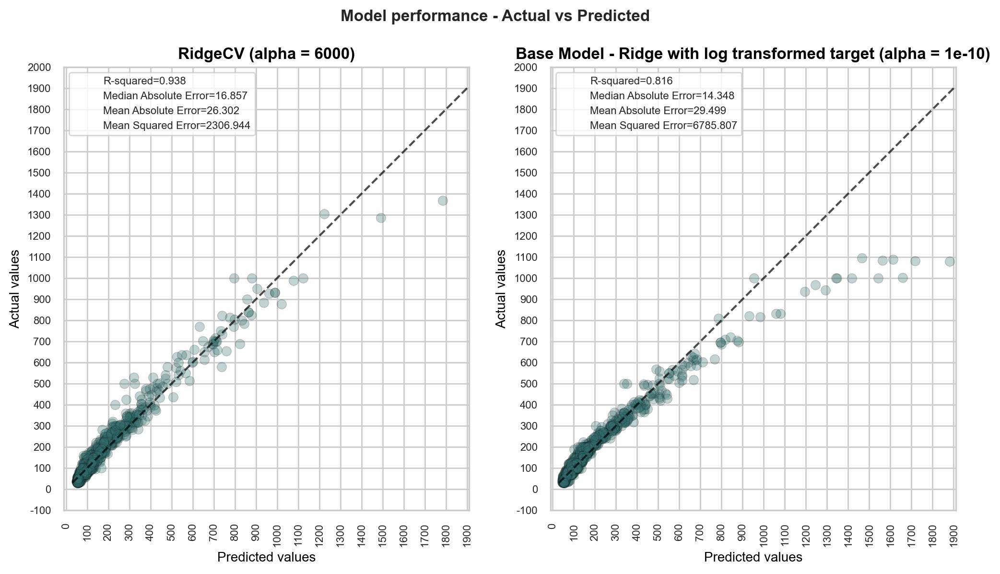

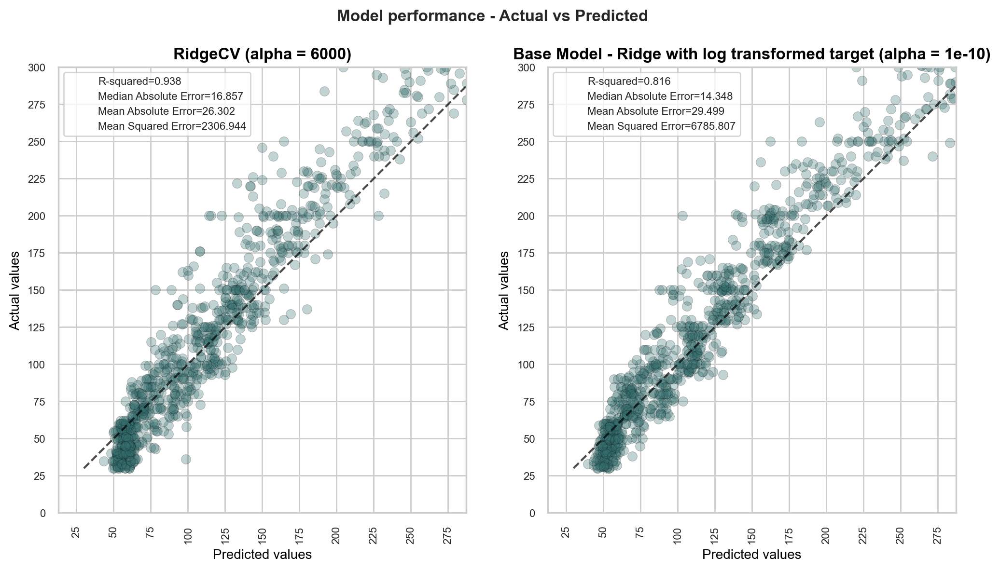

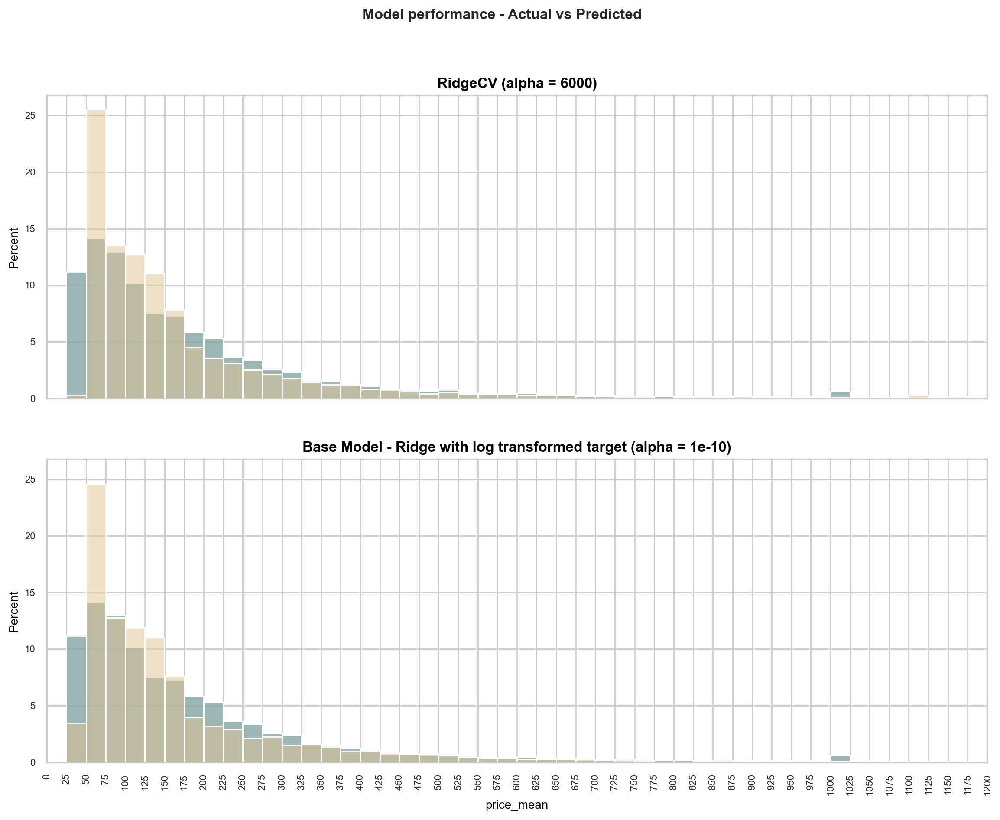

/opt/anaconda3/envs/ds_udacity_projects/lib/python3.10/site-packages/statsmodels/stats/_adnorm.py:67: RuntimeWarning: divide by zero encountered in log1p
  s = np.sum((2 * i[sl1] - 1.0) / nobs * (np.log(z) + np.log1p(-z[sl2])),


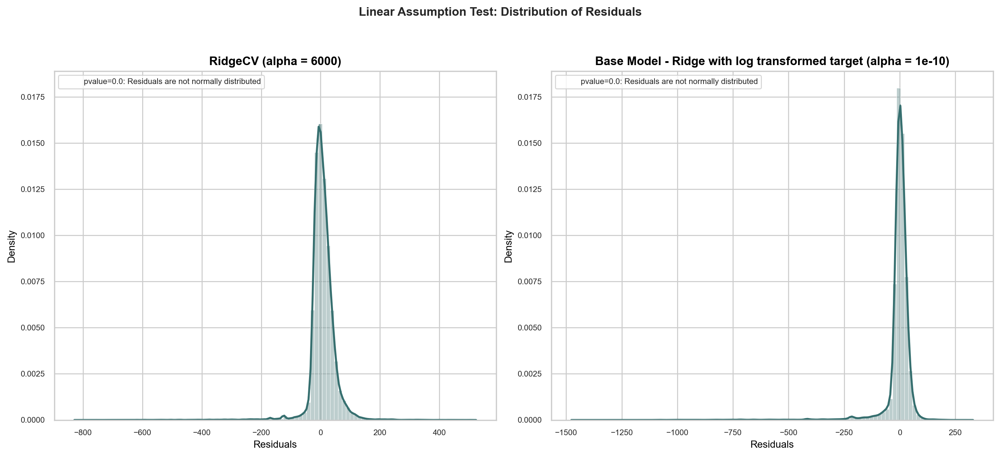

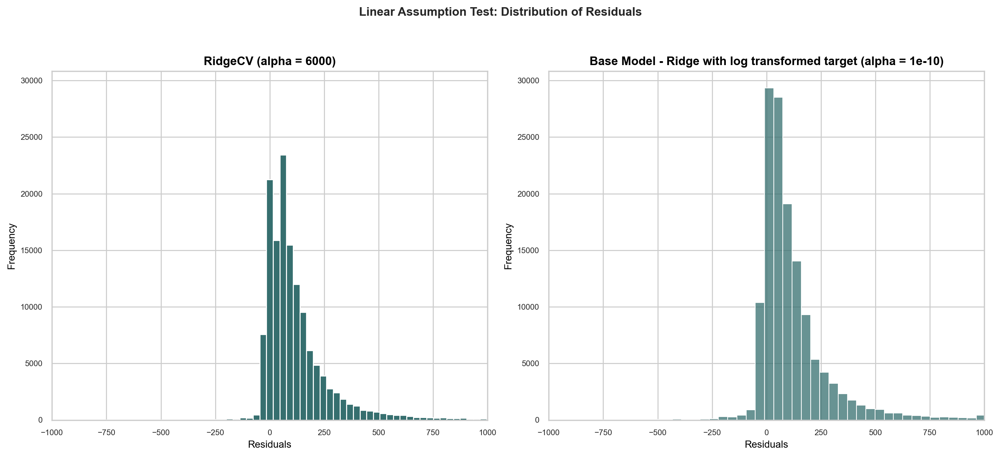

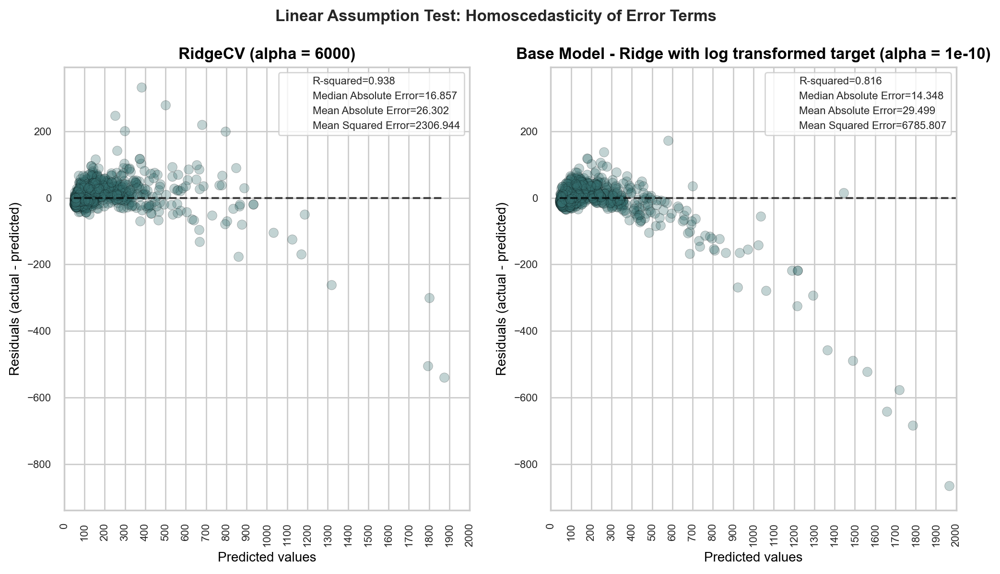

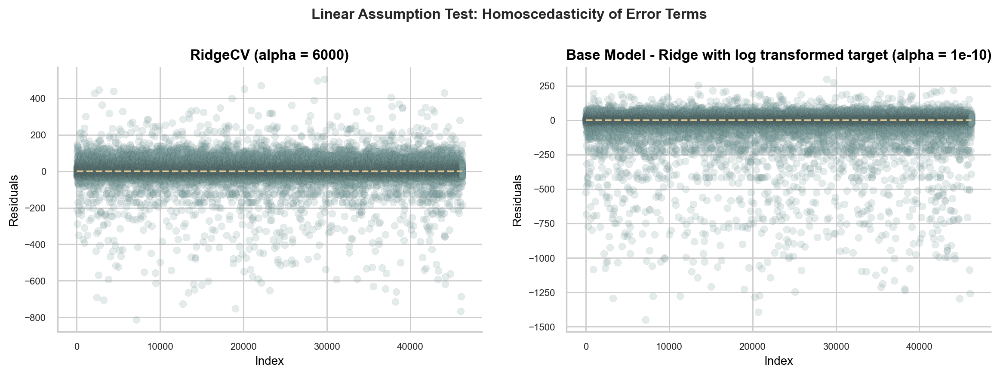

In [326]:
model_evaluation(
    model1=ridgecv, 
    model2=base_model_with_log_target, 
    X=X_train, 
    y=y_train,
    alpha1=alpha_ridgecv,
    alpha2=alpha_base,
    title1='RidgeCV',
    title2='Base Model - Ridge with log transformed target',
    suptitle='Model performance - improvement with RidgeCV'
)

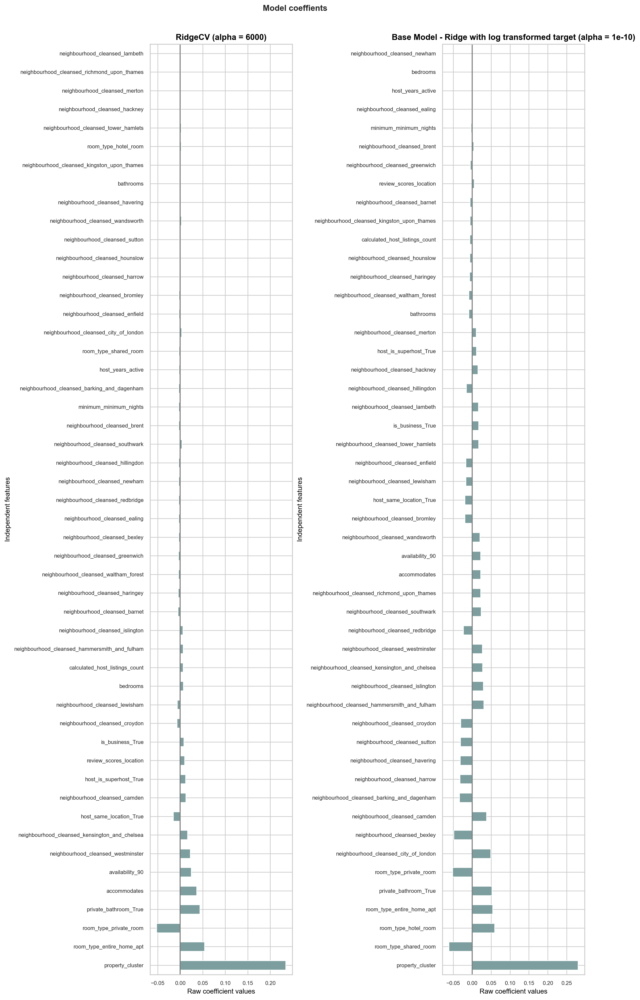

In [338]:
plot_coef(
    model1=ridgecv,
    model2=base_model_with_log_target,
    title1='RidgeCV' + ' (alpha = {})'.format(alpha_ridgecv),
    title2='Base Model - Ridge with log transformed target' + ' (alpha = {})'.format(alpha_base),
    suptitle='Model coeffients',
)

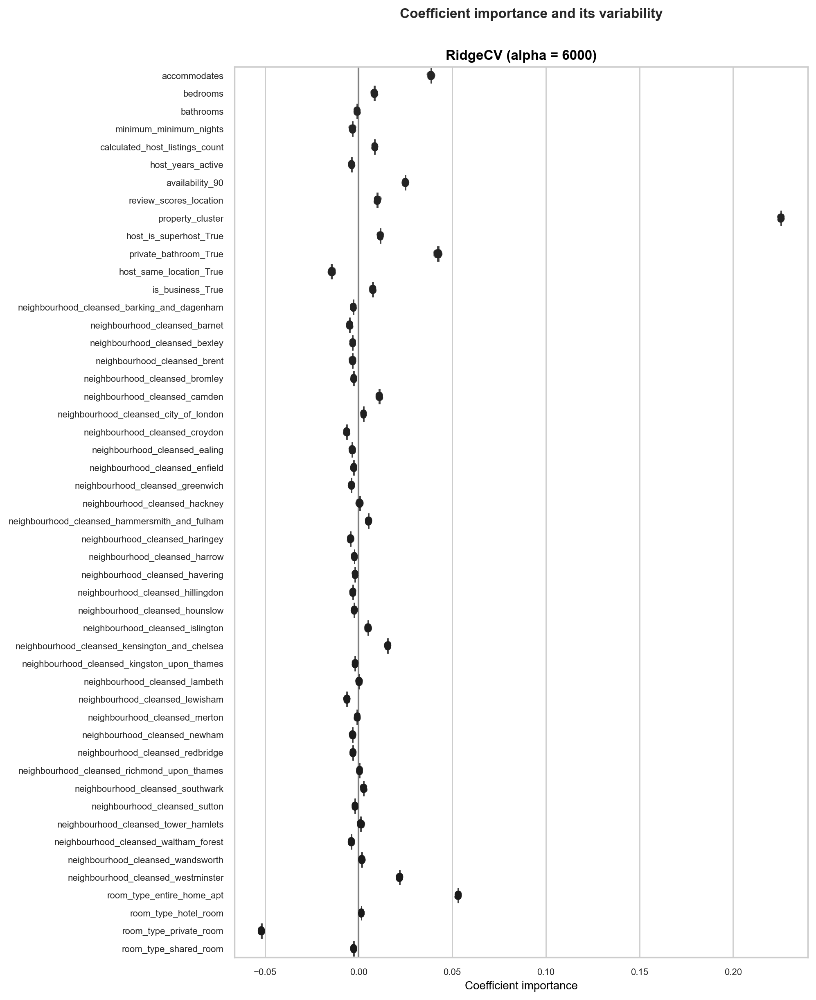

In [316]:
coefficient_variability(
    model=ridgecv, 
    X=X_train, 
    y=y_train, 
    title='RidgeCV' + ' (alpha = {})'.format(alpha_ridgecv),
    suptitle='Coefficient importance and its variability'
)

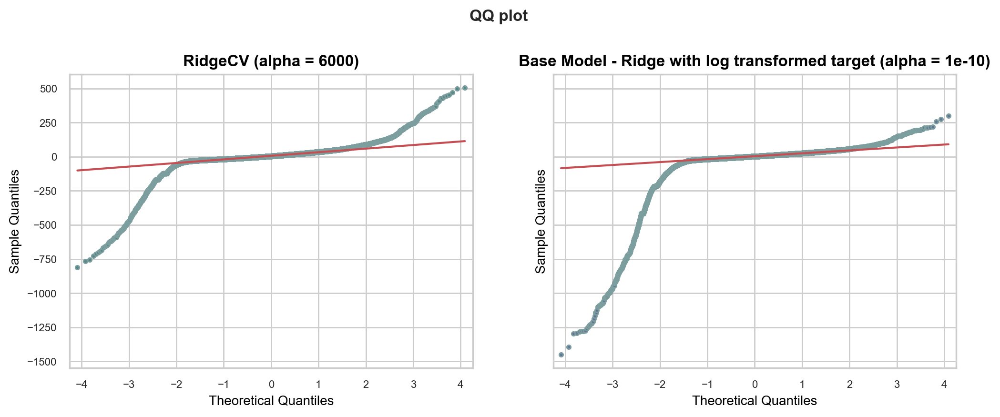

In [337]:
#QQ plot
compare_qqplot(
    ridgecv, 
    base_model_with_log_target, 
    X_train, 
    y_train, 
    title1='RidgeCV' + ' (alpha = {})'.format(alpha_ridgecv),
    title2='Base Model - Ridge with log transformed target' + ' (alpha = {})'.format(alpha_base),
    suptitle='QQ plot',
    figsize=(12,4)
)

# statsmodels model statistics

In [332]:
X_train_transformed = preprocessor.transform(X_train)
X_train_transformed.head(2)

,accommodates,bedrooms,bathrooms,minimum_minimum_nights,calculated_host_listings_count,host_years_active,availability_90,review_scores_location,property_cluster,host_is_superhost_True,private_bathroom_True,host_same_location_True,is_business_True,neighbourhood_cleansed_barking_and_dagenham,neighbourhood_cleansed_barnet,neighbourhood_cleansed_bexley,neighbourhood_cleansed_brent,neighbourhood_cleansed_bromley,neighbourhood_cleansed_camden,neighbourhood_cleansed_city_of_london,neighbourhood_cleansed_croydon,neighbourhood_cleansed_ealing,neighbourhood_cleansed_enfield,neighbourhood_cleansed_greenwich,neighbourhood_cleansed_hackney,neighbourhood_cleansed_hammersmith_and_fulham,neighbourhood_cleansed_haringey,neighbourhood_cleansed_harrow,neighbourhood_cleansed_havering,neighbourhood_cleansed_hillingdon,neighbourhood_cleansed_hounslow,neighbourhood_cleansed_islington,neighbourhood_cleansed_kensington_and_chelsea,neighbourhood_cleansed_kingston_upon_thames,neighbourhood_cleansed_lambeth,neighbourhood_cleansed_lewisham,neighbourhood_cleansed_merton,neighbourhood_cleansed_newham,neighbourhood_cleansed_redbridge,neighbourhood_cleansed_richmond_upon_thames,neighbourhood_cleansed_southwark,neighbourhood_cleansed_sutton,neighbourhood_cleansed_tower_hamlets,neighbourhood_cleansed_waltham_forest,neighbourhood_cleansed_wandsworth,neighbourhood_cleansed_westminster,room_type_entire_home_apt,room_type_hotel_room,room_type_private_room,room_type_shared_room
listing_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
22567214,-1.185163,-0.524097,-0.560721,0.077641,-0.280862,-0.379850,-0.935264,-0.432782,-0.980684,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
18823071,-0.083238,-1.660930,-0.560721,-0.257474,-0.165891,0.234489,-0.966953,0.166502,-0.712188,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0


In [331]:
X_ols = X_train_transformed.copy(deep=True)
X_ols['intercept'] = 1
lm = sm.OLS(y_train, X_ols)
results = lm.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             price_mean   R-squared:                       0.940
Model:                            OLS   Adj. R-squared:                  0.940
Method:                 Least Squares   F-statistic:                 1.501e+04
Date:                Tue, 05 Dec 2023   Prob (F-statistic):               0.00
Time:                        20:18:36   Log-Likelihood:            -2.4396e+05
No. Observations:               46261   AIC:                         4.880e+05
Df Residuals:                   46212   BIC:                         4.884e+05
Df Model:                          48                                         
Covariance Type:            nonrobust                                         
=================================================================================================================
                                                    coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------
accommodates                                     -8.8137      0.393    -22.424      0.000      -9.584      -8.043
bedrooms                                         -2.0490      0.376     -5.443      0.000      -2.787      -1.311
bathrooms                                         4.6238      0.277     16.686      0.000       4.081       5.167
minimum_minimum_nights                            0.0373      0.223      0.167      0.867      -0.401       0.475
calculated_host_listings_count                    9.9120      0.248     40.047      0.000       9.427      10.397
host_years_active                                 0.3288      0.235      1.398      0.162      -0.132       0.790
availability_90                                  -6.8996      0.246    -28.084      0.000      -7.381      -6.418
review_scores_location                           -1.2799      0.225     -5.691      0.000      -1.721      -0.839
property_cluster                                200.3144      0.354    566.362      0.000     199.621     201.008
host_is_superhost_True                           -3.8311      0.767     -4.996      0.000      -5.334      -2.328
private_bathroom_True                           -10.2106      0.746    -13.685      0.000     -11.673      -8.748
host_same_location_True                           4.2068      0.674      6.240      0.000       2.885       5.528
is_business_True                                -13.3335      1.134    -11.762      0.000     -15.555     -11.112
neighbourhood_cleansed_barking_and_dagenham      12.4083      2.581      4.808      0.000       7.350      17.466
neighbourhood_cleansed_barnet                     5.2908      1.362      3.885      0.000       2.621       7.960
neighbourhood_cleansed_bexley                    19.4542      2.750      7.074      0.000      14.064      24.845
neighbourhood_cleansed_brent                      2.9066      1.230      2.363      0.018       0.496       5.318
neighbourhood_cleansed_bromley                   15.8707      2.330      6.812      0.000      11.304      20.437
neighbourhood_cleansed_camden                    -9.5268      0.890    -10.703      0.000     -11.271      -7.782
neighbourhood_cleansed_city_of_london           -23.4097      2.710     -8.637      0.000     -28.722     -18.097
neighbourhood_cleansed_croydon                   15.7488      1.647      9.562      0.000      12.521      18.977
neighbourhood_cleansed_ealing                     4.6749      1.358      3.442      0.001       2.013       7.337
neighbourhood_cleansed_enfield                   11.8298      2.210      5.354      0.000       7.499      16.161
neighbourhood_cleansed_greenwich                  6.2646      1.471      4.259      0.000       3.382       9.148
neigh

# references
- [Common pitfalls in the interpretation of coefficients of linear models](https://scikit-learn.org/stable/auto_examples/inspection/plot_linear_model_coefficient_interpretation.html)
- [Mixed-type imputation for IterativeImputer](https://github.com/scikit-learn/scikit-learn/issues/17087)
- [kaggle feature engineering lesson](https://www.kaggle.com/learn/feature-engineering)
- [boston house prices](https://www.kaggle.com/code/hikmatullahmohammadi/house-price-prediction-eda-step-by-step)
- [linear regression assumptions](https://jeffmacaluso.github.io/post/LinearRegressionAssumptions/)
- [Regularization of linear regression model](https://inria.github.io/scikit-learn-mooc/python_scripts/linear_models_regularization.html)
- [pipeline for multiple predictors](https://scikit-learn.org/stable/auto_examples/ensemble/plot_stack_predictors.html#sphx-glr-auto-examples-ensemble-plot-stack-predictors-py)
- [when to use gamma GLMS](https://stats.stackexchange.com/questions/67547/when-to-use-gamma-glms)
- [feature engineering - clustering with K-means](https://www.kaggle.com/code/ryanholbrook/clustering-with-k-means)
- [using FACETGRID to plot geopandas maps](https://stackoverflow.com/questions/32117579/pandas-plots-on-seaborn-facetgrid?rq=4)
- [QQ plots](https://www.blog.dailydoseofds.com/p/a-visual-and-intuitive-guide-to-qq?utm_source=post-email-title&publication_id=1119889&post_id=138326464&utm_campaign=email-post-title&isFreemail=true&r=25q7g0)